<h1 style='color:white; background:#50A8E3; border:0'><center>Acea Smart Water: Full EDA & Prediction</center></h1>

![Water](https://images.immediate.co.uk/production/volatile/sites/4/2018/07/iStock_69791979_XXLARGE_1-c9eba8a.jpg?quality=90&resize=940%2C400)

**The Acea Group is one of the leading Italian multiutility operators. Listed on the Italian Stock Exchange since 1999, the company manages and develops water and electricity networks and environmental services. Acea is the foremost Italian operator in the water services sector supplying 9 million inhabitants in Lazio, Tuscany, Umbria, Molise, Campania.**

**This competition uses nine different datasets, completely independent and not linked to each other. Each dataset can represent a different kind of waterbody. As each waterbody is different from the other, the related features as well are different from each other.**

<a id="section-start"></a>

<h2 style='color:white; background:#50A8E3; border:0'><center>Here you'll find:</center></h2>

* EDA
* Some ideas for predictions
* Predictions


1. [**Loading and a first look at the data**](#section-one) <br>
2. [**EDA**](#section-two) <br>
 [...Aquifer_Doganella](#section-three) <br>
 [...Aquifer_Auser](#section-four) <br>
 [...Water_Spring_Amiata](#section-five) <br>
 [...Lake_Bilancino](#section-six) <br>
 [...Water_Spring_Madonna_di_Canneto](#section-seven) <br>
 [...Aquifer_Luco](#section-eight) <br>
 [...Aquifer_Petrignano](#section-nine) <br>
 [...Water_Spring_Lupa](#section-ten) <br>
 [...River_Arno](#section-eleven) <br>
3. [**Feature overview and prediction**](#section-twelve) <br>
 [...River Arno (features)](#section-thirteen) <br>
 [...**River Arno (prediction)**](#section-1) <br>
 
 [...Lake Bilancino (features)](#section-fourteen) <br>
 [...**Lake Bilancino (prediction)**](#section-2) <br>
 
 [...Aquifer Petrignano (features)](#section-fifteen) <br>
 [...**Aquifer Petrignano (prediction)**](#section-3) <br>
 
 [...Aquifer Auser (features)](#section-nineteen) <br>
 [...**Aquifer Auser (prediction)**](#section-4) <br>
 
 [...Aquifer Doganella (features)](#section-twenty) <br>
 [...**Aquifer Doganella (prediction)**](#section-5) <br>
 
 [...Aquifer Luco (features)](#section-twentyone) <br>
 [...**Aquifer Luco (prediction)**](#section-6) <br>
 
 [...Water Spring Madonna di Canneto (features)](#section-sixteen) <br>
 [...**Water Spring Madonna di Canneto (prediction)**](#section-7) <br>
 
 [...Water Spring Lupa (features)](#section-seventeen) <br>
 [...**Water Spring Lupa (prediction)**](#section-8) <br>
 
 [...Water Spring Amiata (features)](#section-eighteen) <br>
 [...**Water Spring Amiata (prediction)**](#section-9) <br>

In [1]:
# loading packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
plt.rcParams['figure.dpi'] = 300

import matplotlib.dates as mdates

from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor

# ignoring warnings
import warnings
warnings.simplefilter("ignore")

In [2]:
print('Datasets:')
os.listdir('c:/Users/waelr/Desktop/Python/acea-water-prediction')

Datasets:


['Aquifer_Auser.csv',
 'Aquifer_Doganella.csv',
 'Aquifer_Luco.csv',
 'Aquifer_Petrignano.csv',
 'datasets_description.ods',
 'datasets_description.xlsx',
 'Lake_Bilancino.csv',
 'River_Arno.csv',
 'Water_Spring_Amiata.csv',
 'Water_Spring_Lupa.csv',
 'Water_Spring_Madonna_di_Canneto.csv']

In [3]:
import glob

In [4]:
csv_files = glob.glob('c:/Users/waelr/Desktop/python/acea-water-prediction/*.csv')

In [5]:
csv_files

['c:/Users/waelr/Desktop/python/acea-water-prediction\\Aquifer_Auser.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\Aquifer_Doganella.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\Aquifer_Luco.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\Aquifer_Petrignano.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\Lake_Bilancino.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\River_Arno.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\Water_Spring_Amiata.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\Water_Spring_Lupa.csv',
 'c:/Users/waelr/Desktop/python/acea-water-prediction\\Water_Spring_Madonna_di_Canneto.csv']

In [6]:
# not effective way 
Aquifer_Auser = csv_files[0]
Aquifer_Doganella = csv_files[1]
Aquifer_Luco = csv_files[2]
Aquifer_Petrignano = csv_files[3]
Lake_Bilancino = csv_files[4]
River_Arno = csv_files[5]
Water_Spring_Amiata = csv_files[6]
Water_Spring_Lupa = csv_files[7]
Water_Spring_Madonna_di_Canneto = csv_files[8]



In [7]:
Aquifer_Auser

'c:/Users/waelr/Desktop/python/acea-water-prediction\\Aquifer_Auser.csv'

In [6]:
#  Iterate over csv_files
for csv in csv_files:

    #  Read csv into a DataFrame: df
    df = pd.read_csv(csv)

In [7]:
Aquifer_Doganella = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Aquifer_Doganella.csv', index_col = 'Date')
Aquifer_Auser = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Aquifer_Auser.csv', index_col = 'Date')
Water_Spring_Amiata = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Water_Spring_Amiata.csv', index_col = 'Date')
Lake_Bilancino = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Lake_Bilancino.csv', index_col = 'Date')
Water_Spring_Madonna_di_Canneto = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Water_Spring_Madonna_di_Canneto.csv', index_col = 'Date')
Aquifer_Luco = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Aquifer_Luco.csv', index_col = 'Date')
Aquifer_Petrignano = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Aquifer_Petrignano.csv', index_col = 'Date')
Water_Spring_Lupa = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/Water_Spring_Lupa.csv', index_col = 'Date')
River_Arno = pd.read_csv('c:/Users/waelr/Desktop/python/acea-water-prediction/River_Arno.csv', index_col = 'Date')


print('Datasets shape:')
print('*'*30)
print('Aquifer_Doganella: {}'.format(Aquifer_Doganella.shape))
print('Aquifer_Auser: {}'.format(Aquifer_Auser.shape))
print('Water_Spring_Amiata: {}'.format(Water_Spring_Amiata.shape))
print('Lake_Bilancino: {}'.format(Lake_Bilancino.shape))
print('Water_Spring_Madonna_di_Canneto: {}'.format(Water_Spring_Madonna_di_Canneto.shape))
print('Aquifer_Luco: {}'.format(Aquifer_Luco.shape))
print('Aquifer_Petrignano: {}'.format(Aquifer_Petrignano.shape))
print('Water_Spring_Lupa: {}'.format(Water_Spring_Lupa.shape))
print('River_Arno: {}'.format(River_Arno.shape))

Datasets shape:
******************************
Aquifer_Doganella: (6026, 21)
Aquifer_Auser: (8154, 26)
Water_Spring_Amiata: (7487, 15)
Lake_Bilancino: (6603, 8)
Water_Spring_Madonna_di_Canneto: (3113, 3)
Aquifer_Luco: (7487, 21)
Aquifer_Petrignano: (5223, 7)
Water_Spring_Lupa: (4199, 2)
River_Arno: (8217, 16)


In [8]:
datasets = [Aquifer_Doganella, Aquifer_Auser, Water_Spring_Amiata,
            Lake_Bilancino, Water_Spring_Madonna_di_Canneto, Aquifer_Luco,
            Aquifer_Petrignano, Water_Spring_Lupa, River_Arno]

datasets_names = ['Aquifer_Doganella', 'Aquifer_Auser', 'Water_Spring_Amiata',
                'Lake_Bilancino', 'Water_Spring_Madonna_di_Canneto', 'Aquifer_Luco',
                'Aquifer_Petrignano', 'Water_Spring_Lupa', 'River_Arno']

In [9]:
print('Datasets dtypes:')
print('*'*30)
for i in range(len(datasets)):
    print('{}: \n{}'.format(datasets_names[i], datasets[i].dtypes.value_counts()))
    print('-'*20)

Datasets dtypes:
******************************
Aquifer_Doganella: 
float64    21
dtype: int64
--------------------
Aquifer_Auser: 
float64    26
dtype: int64
--------------------
Water_Spring_Amiata: 
float64    15
dtype: int64
--------------------
Lake_Bilancino: 
float64    8
dtype: int64
--------------------
Water_Spring_Madonna_di_Canneto: 
float64    3
dtype: int64
--------------------
Aquifer_Luco: 
float64    21
dtype: int64
--------------------
Aquifer_Petrignano: 
float64    7
dtype: int64
--------------------
Water_Spring_Lupa: 
float64    2
dtype: int64
--------------------
River_Arno: 
float64    16
dtype: int64
--------------------


In [ ]:
def line_plot(data, y, title, color,
              top_visible = False, right_visible = False, 
              bottom_visible = True, left_visible = False,
              ylabel = None, figsize = (10, 4), axis_grid = 'y'):
    fig, ax = plt.subplots(figsize = figsize)
    plt.title(title, size = 15, fontweight = 'bold', fontfamily = 'serif')

    for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_color('black')
    
    ax.spines['top'].set_visible(top_visible)
    ax.spines['right'].set_visible(right_visible)
    ax.spines['bottom'].set_visible(bottom_visible)
    ax.spines['left'].set_visible(left_visible)
    
    sns.lineplot(x = range(len(data[y])), y = data[y], dashes = False, 
                 color = color, linewidth = .5)
    ax.xaxis.set_major_locator(plt.MaxNLocator(20))
    
    ax.set_xticks([])
    plt.xticks(rotation = 90)
    plt.xlabel('')
    plt.ylabel(ylabel, fontfamily = 'serif')
    ax.grid(axis = axis_grid, linestyle = '--', alpha = 0.9)
    plt.show()

def corr_plot(data,
              top_visible = False, right_visible = False, 
              bottom_visible = True, left_visible = False,
              ylabel = None, figsize = (15, 11), axis_grid = 'y'):
    fig, ax = plt.subplots(figsize = figsize)
    plt.title('Correlations (Pearson)', size = 15, fontweight = 'bold', fontfamily = 'serif')
    
    mask = np.triu(np.ones_like(data.corr(), dtype = bool))
    sns.heatmap(round(data.corr(), 2), mask = mask, cmap = 'viridis', annot = True)
    plt.show()
    
def columns_viz(data, color):
    for i in range(len(data.columns)):
        line_plot(data = data, y = data.columns[i],
                  color = color,
                  title = '{} dynamics'.format(data.columns[i]),
                  bottom_visible = False, figsize = (10, 2))

Note: NumExpr detected 12 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
NumExpr defaulting to 8 threads.


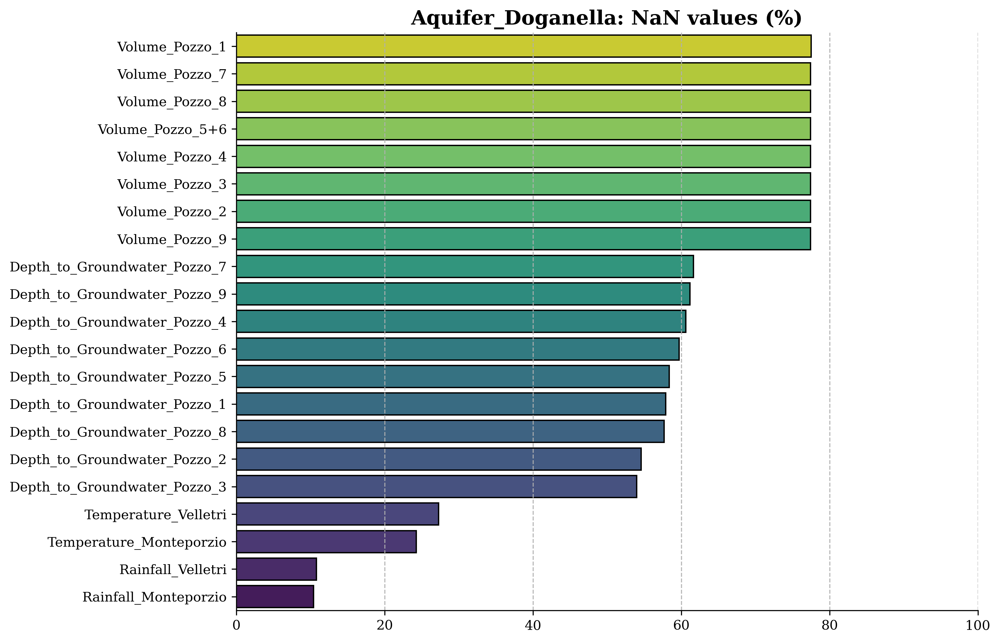

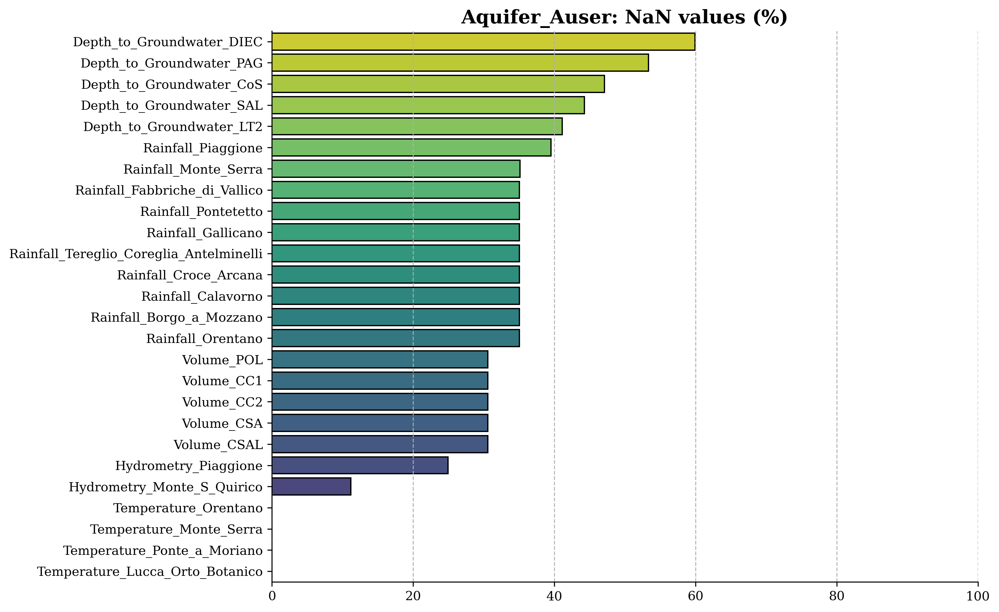

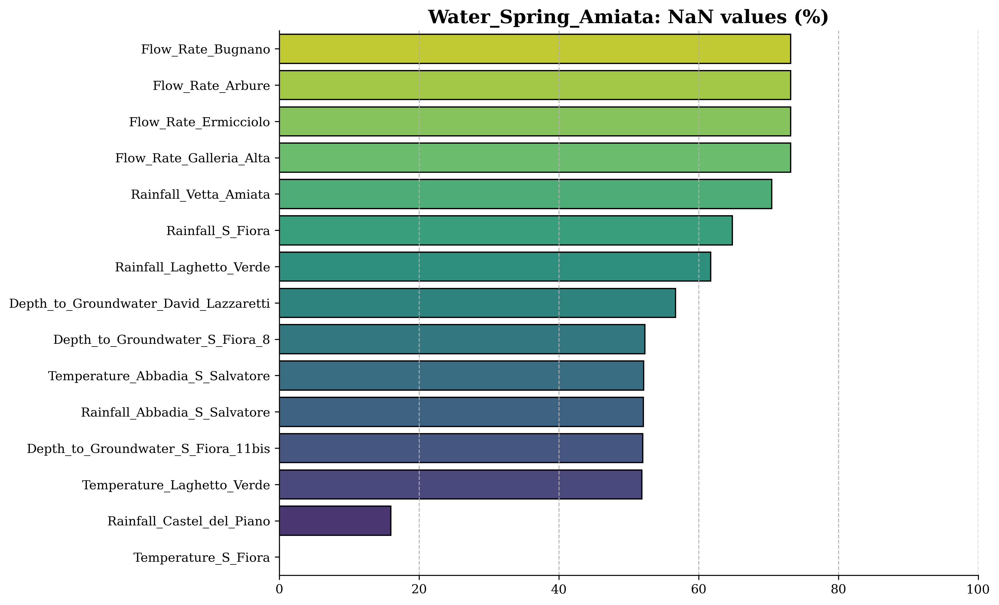

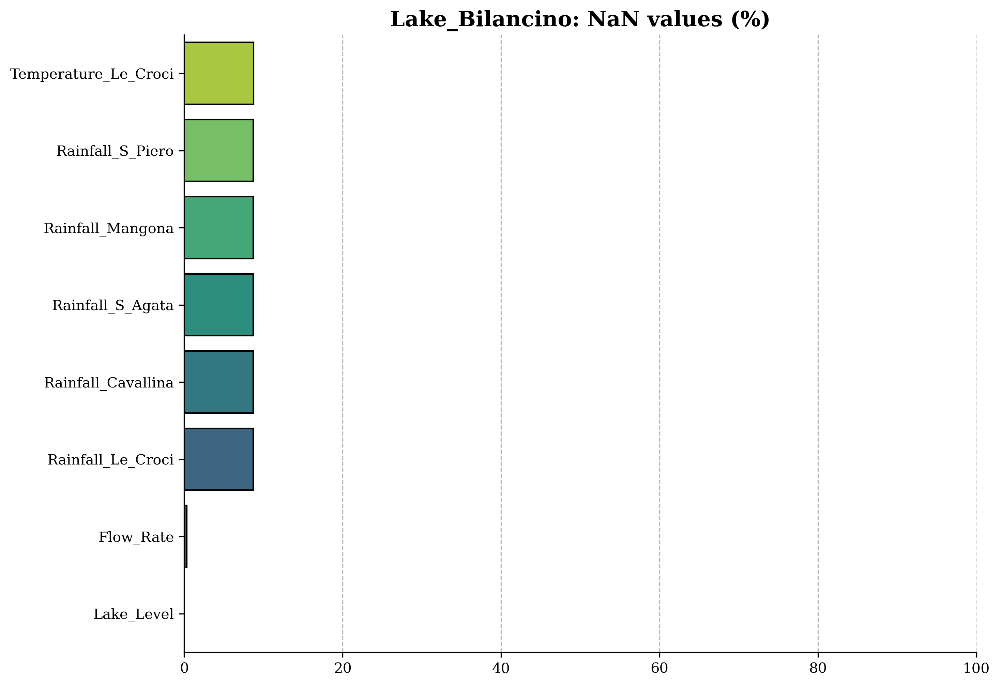

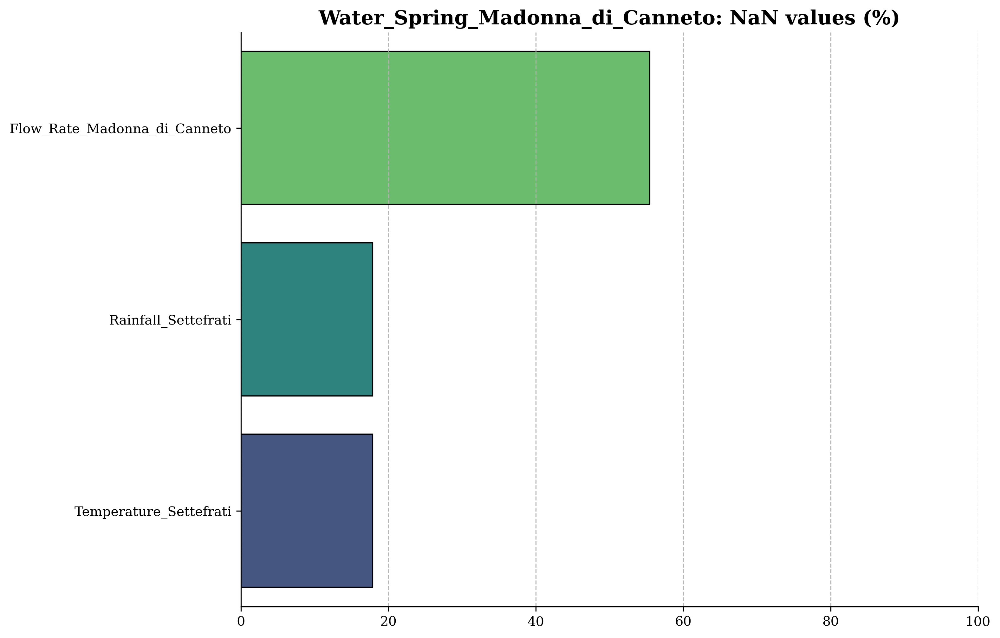

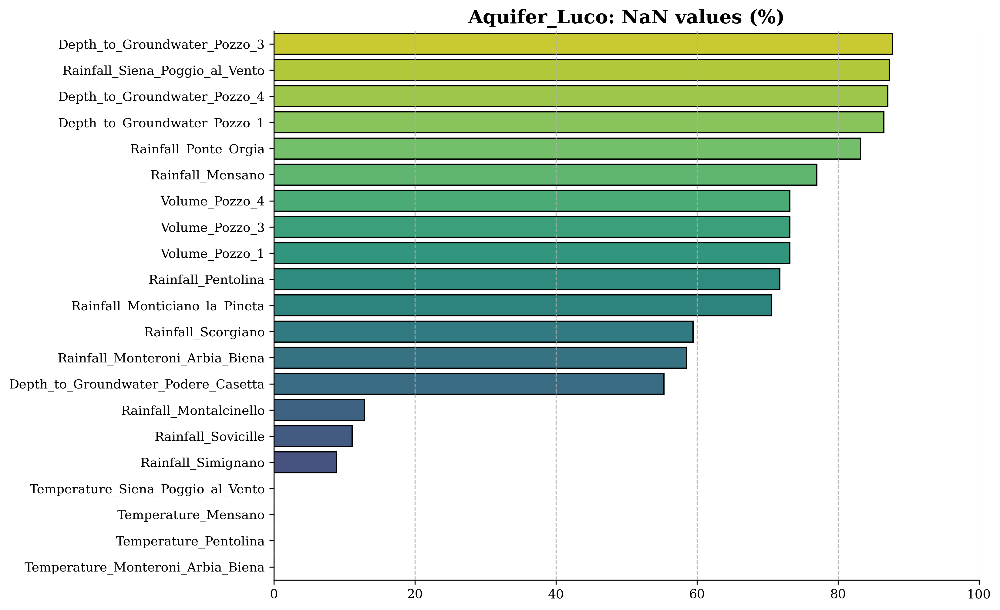

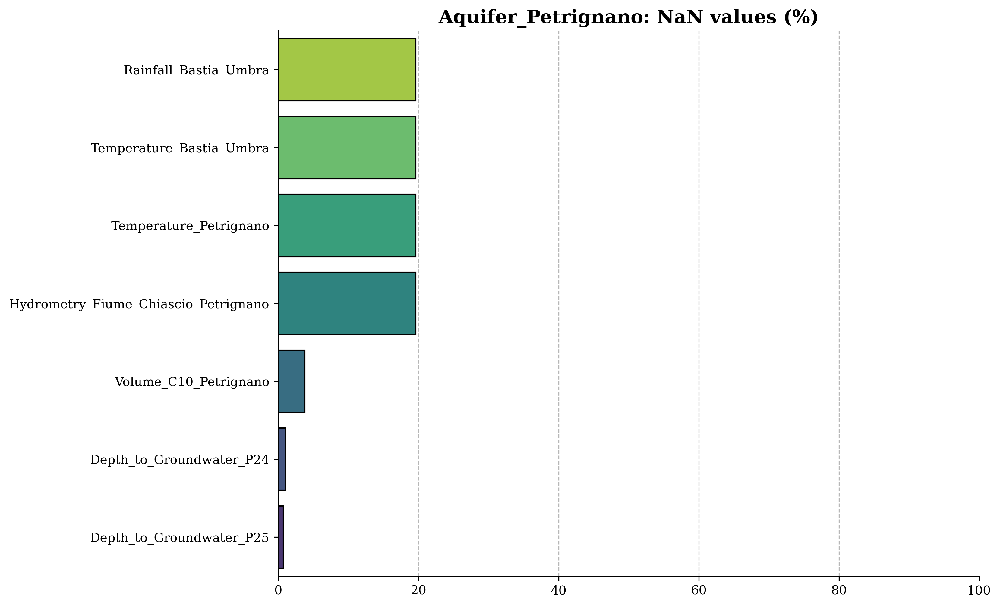

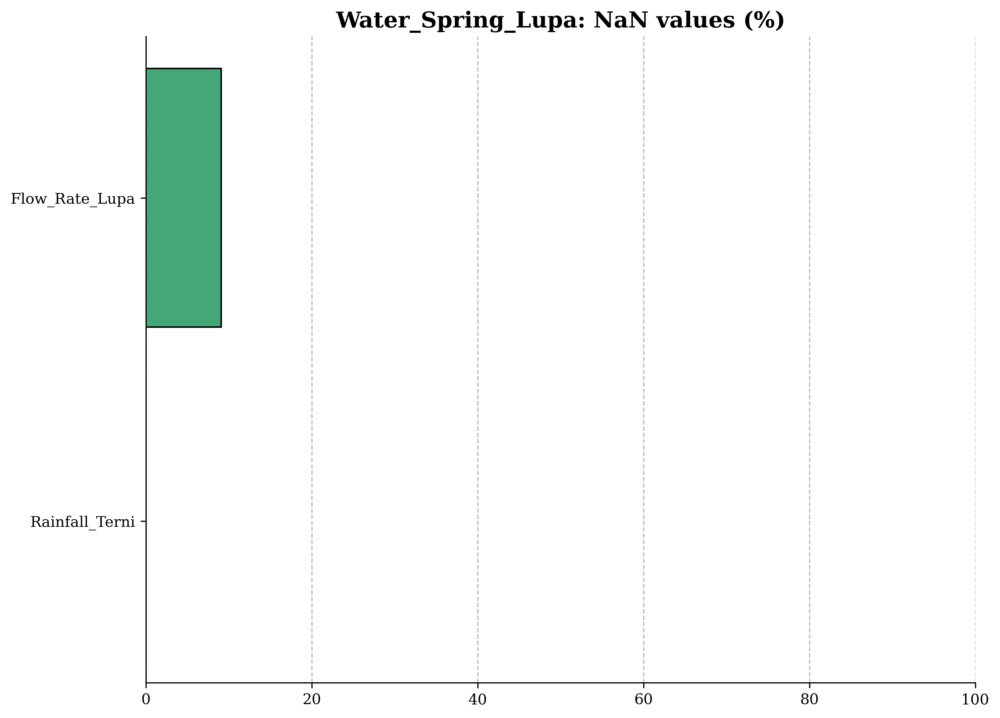

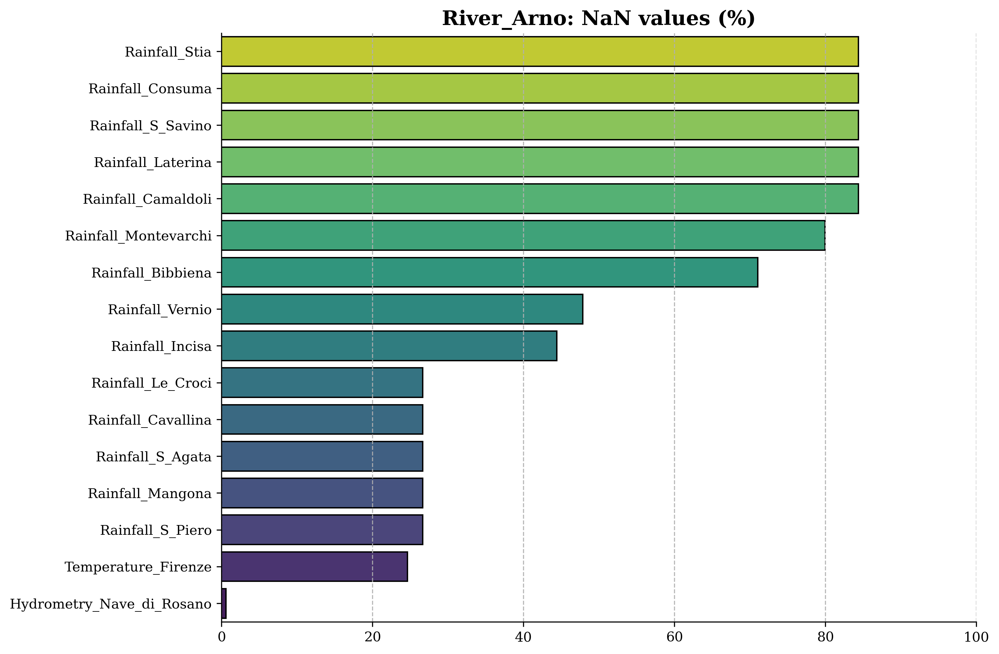

In [11]:
for i in range(len(datasets)):
    NaN_values = (datasets[i].isnull().sum() / len(datasets[i]) * 100).sort_values(ascending = False)
    bar_plot(x = NaN_values, 
             y = NaN_values.index,
             title = '{}: NaN values (%)'.format(datasets_names[i]),
             palette_len = NaN_values.index, 
             xlim = (0, 100), 
             xticklabels = range(0, 101, 20),
             yticklabels = NaN_values.index,
             left_visible = True,
             figsize = (10, 8), axis_grid = 'x')

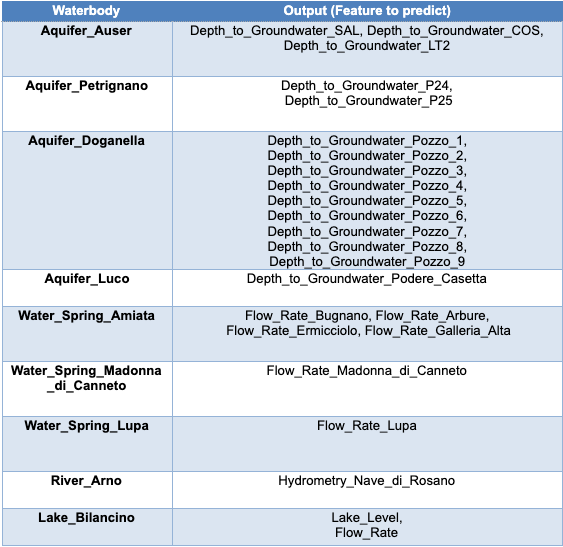

In [13]:
datasets[0].head()

,Rainfall_Monteporzio,Rainfall_Velletri,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_2,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Depth_to_Groundwater_Pozzo_5,Depth_to_Groundwater_Pozzo_6,Depth_to_Groundwater_Pozzo_7,Depth_to_Groundwater_Pozzo_8,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
Date,,,,,,,,,,,,,,,,,,,,,
01/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.30,8.60
02/01/2004,0.2,0.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.70,6.25
03/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.40,9.80
04/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.35,5.95
05/01/2004,0.2,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.60,5.85


In [14]:
print('The earliest date: \t%s' %datasets[0].index.values[[0, -1]])
print('The latest date: \t%s' %datasets[0].index.values[[0, -1]])

The earliest date: 	['01/01/2004' '30/06/2020']
The latest date: 	['01/01/2004' '30/06/2020']


In [15]:
print('The earliest date: \t%s' %datasets[0].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[0].index.values[[0, -1]][1])

The earliest date: 	01/01/2004
The latest date: 	30/06/2020


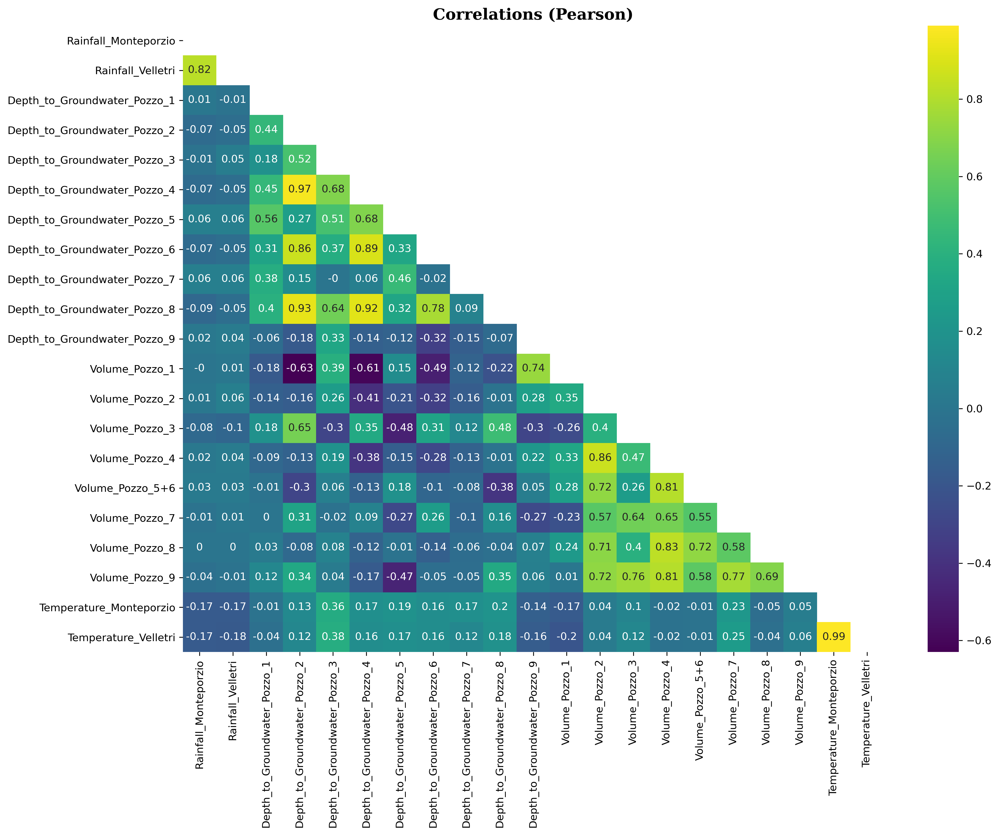

In [16]:
corr_plot(datasets[0])

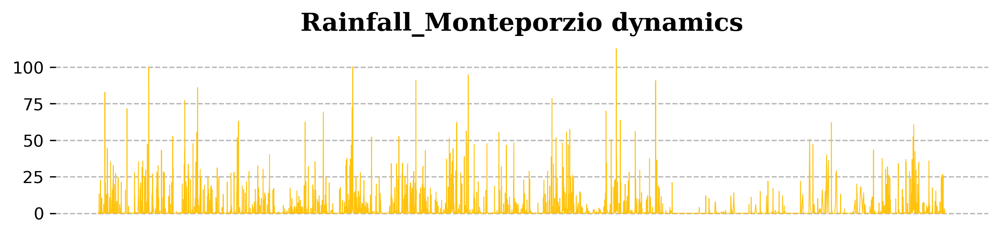

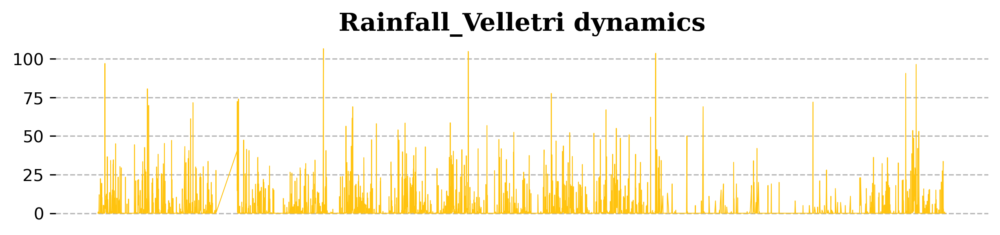

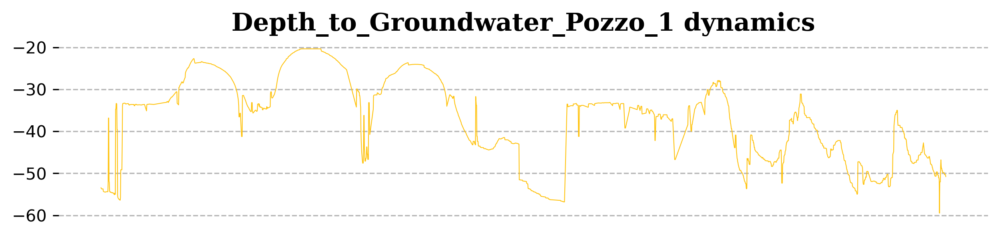

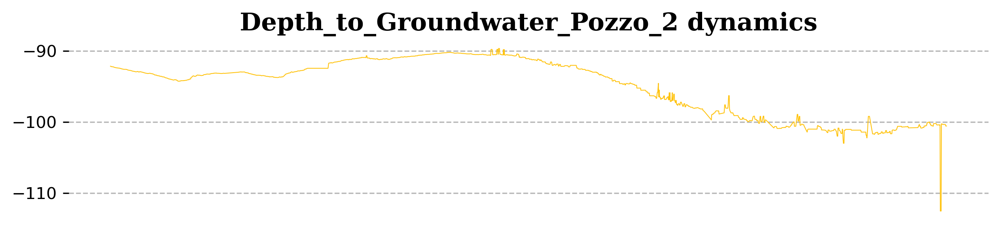

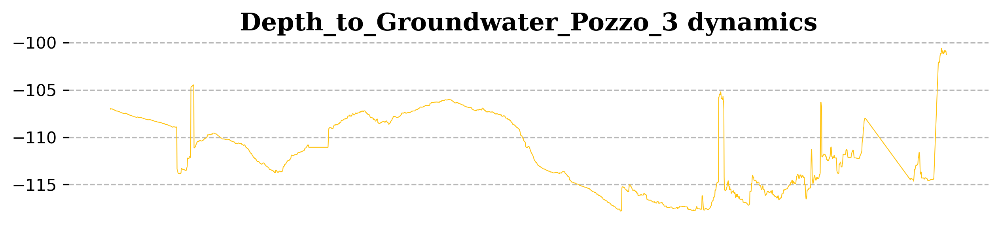

...

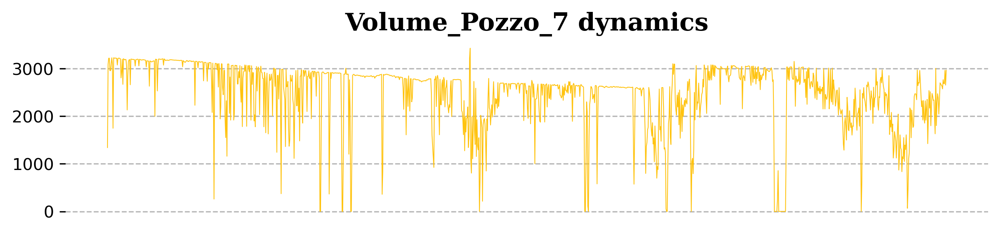

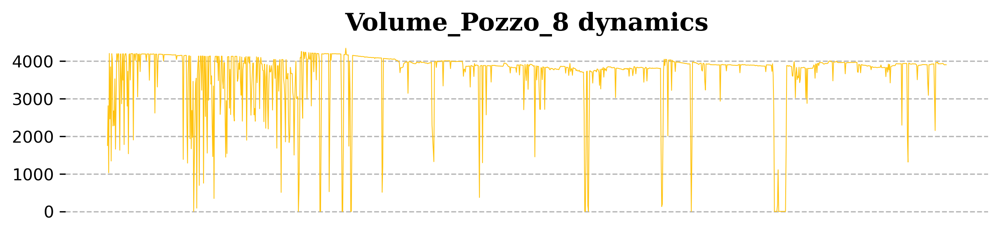

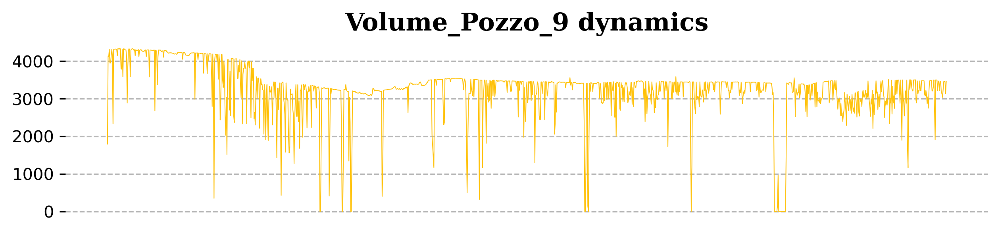

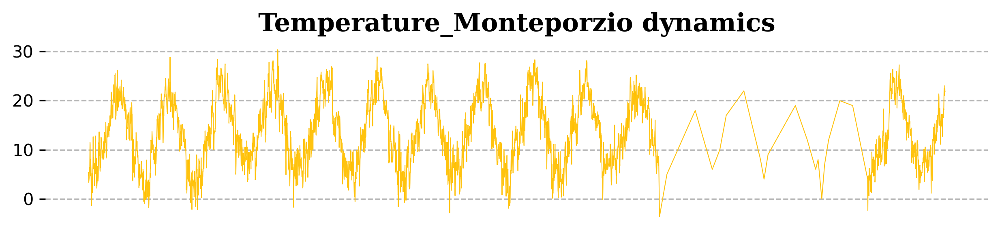

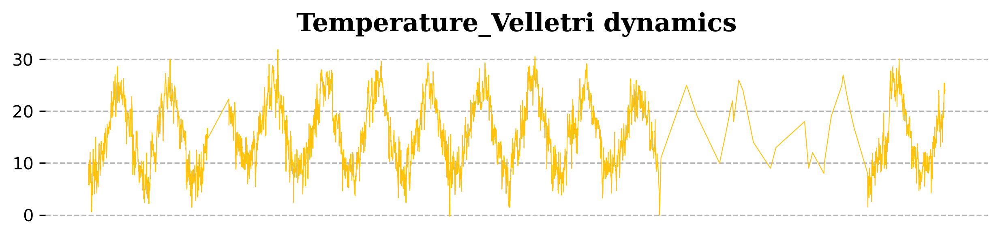

In [17]:
columns_viz(datasets[0], color = '#FFC30F')

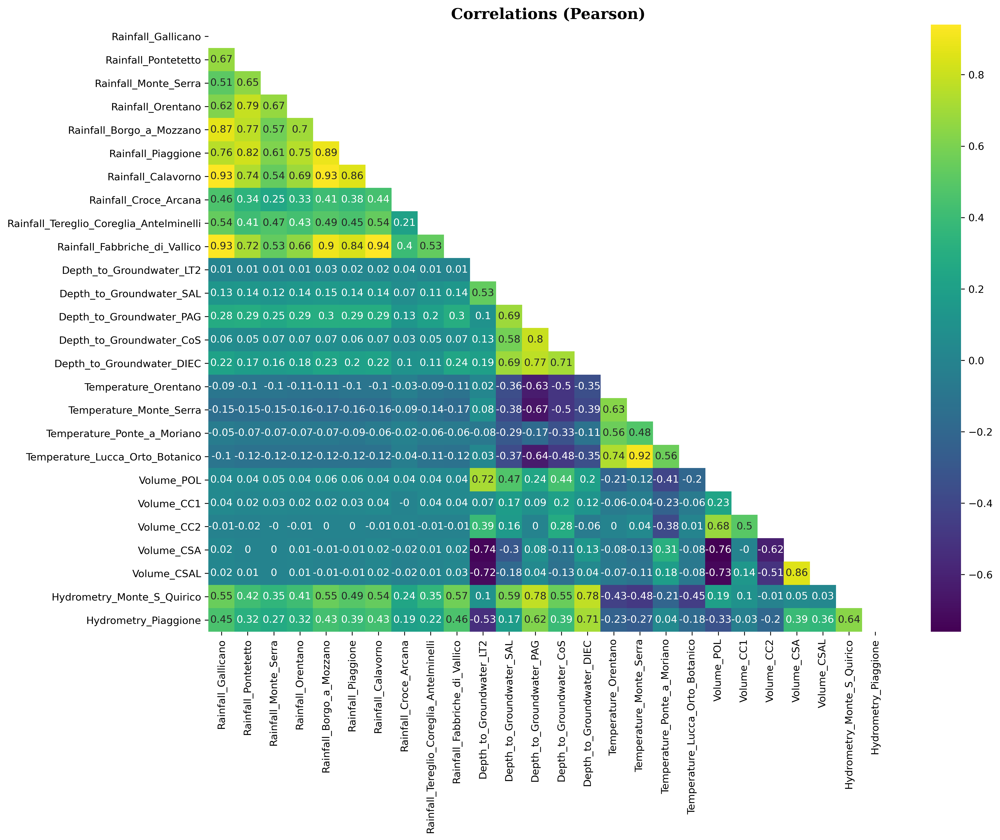

In [20]:
corr_plot(datasets[1])

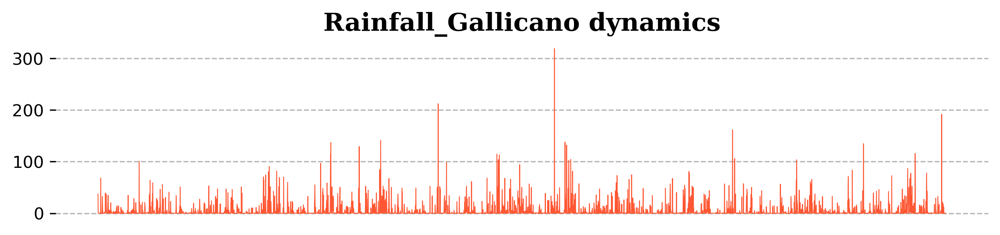

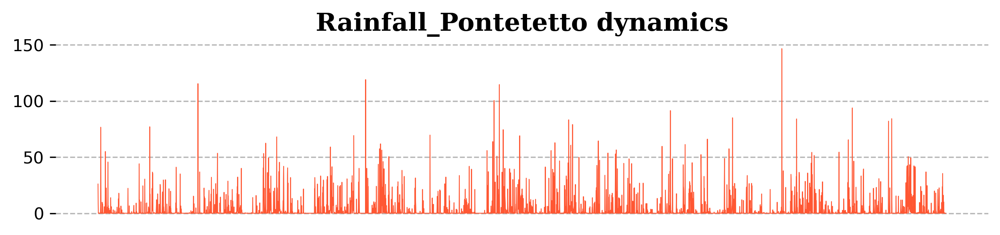

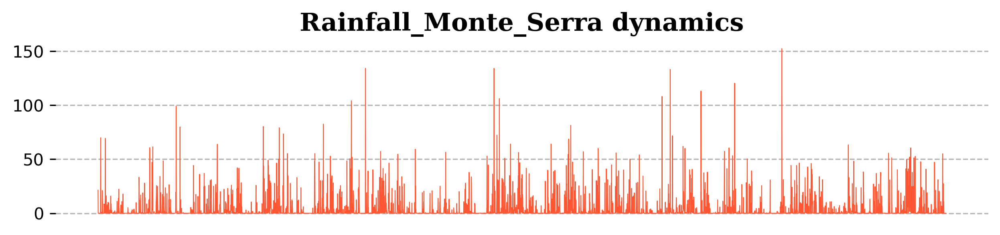

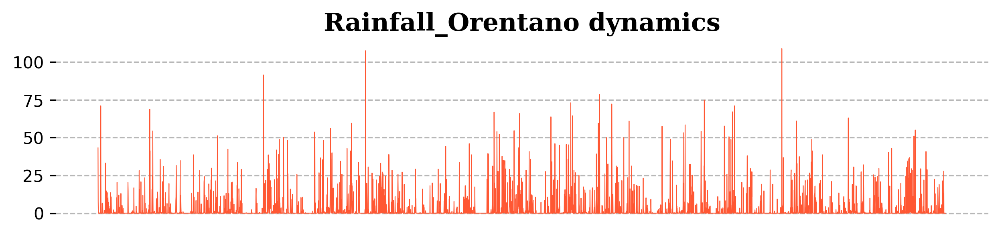

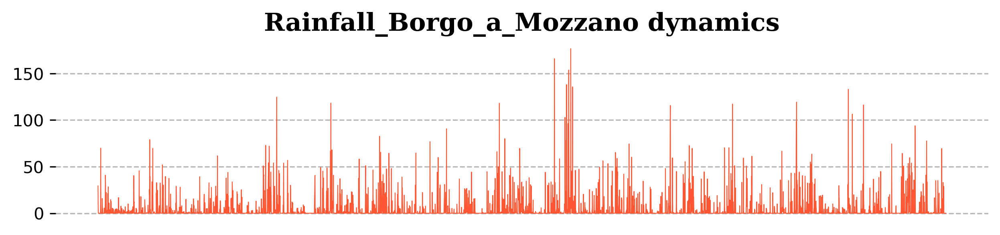

...

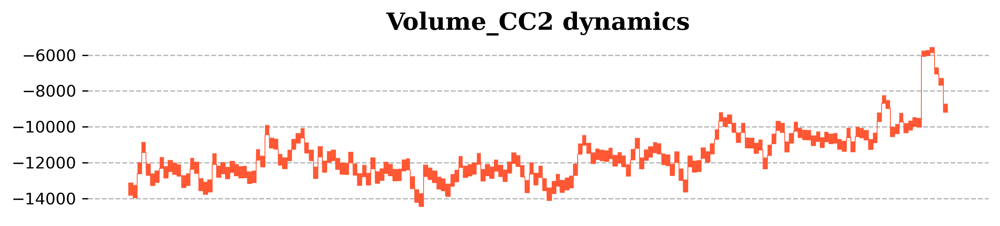

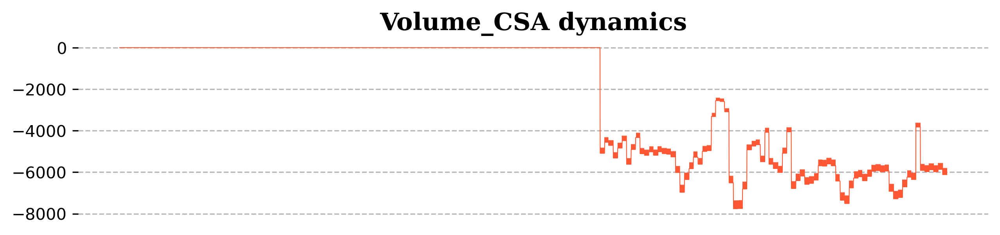

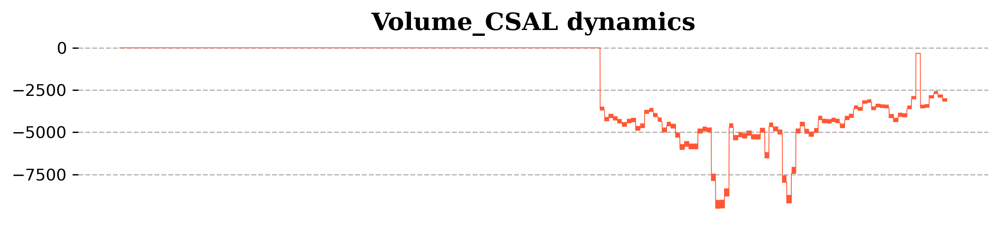

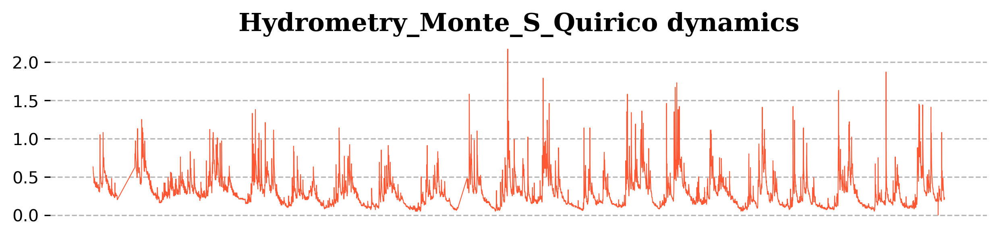

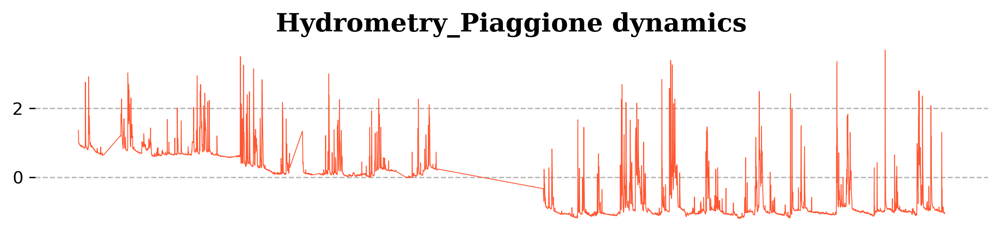

In [21]:
columns_viz(datasets[1], color = '#FF5733')

In [18]:
datasets[2].head()

,Rainfall_Castel_del_Piano,Rainfall_Abbadia_S_Salvatore,Rainfall_S_Fiora,Rainfall_Laghetto_Verde,Rainfall_Vetta_Amiata,Depth_to_Groundwater_S_Fiora_8,Depth_to_Groundwater_S_Fiora_11bis,Depth_to_Groundwater_David_Lazzaretti,Temperature_Abbadia_S_Salvatore,Temperature_S_Fiora,Temperature_Laghetto_Verde,Flow_Rate_Bugnano,Flow_Rate_Arbure,Flow_Rate_Ermicciolo,Flow_Rate_Galleria_Alta
Date,,,,,,,,,,,,,,,
01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.15,NaN,NaN,NaN,NaN,NaN
02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.55,NaN,NaN,NaN,NaN,NaN
03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.70,NaN,NaN,NaN,NaN,NaN
04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.00,NaN,NaN,NaN,NaN,NaN
05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.60,NaN,NaN,NaN,NaN,NaN


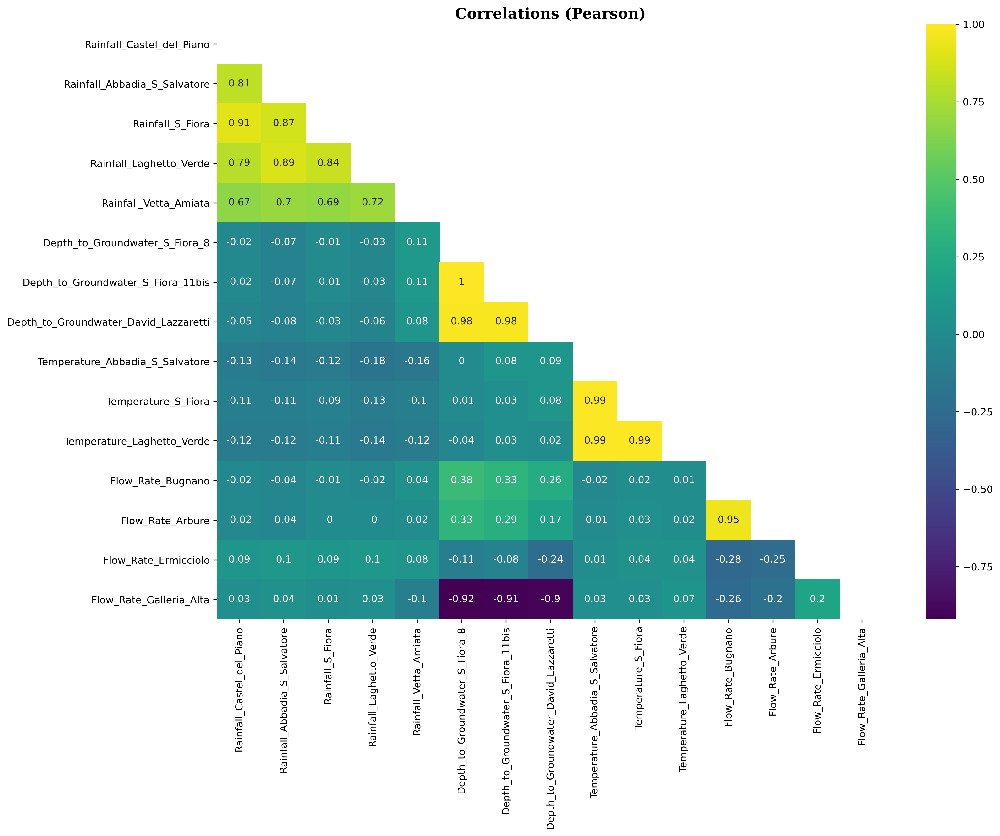

In [23]:
corr_plot(datasets[2])

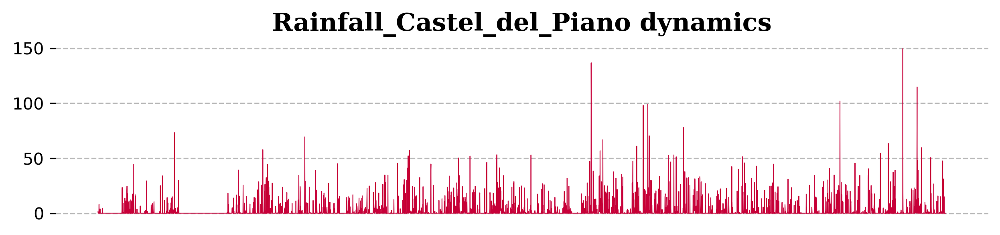

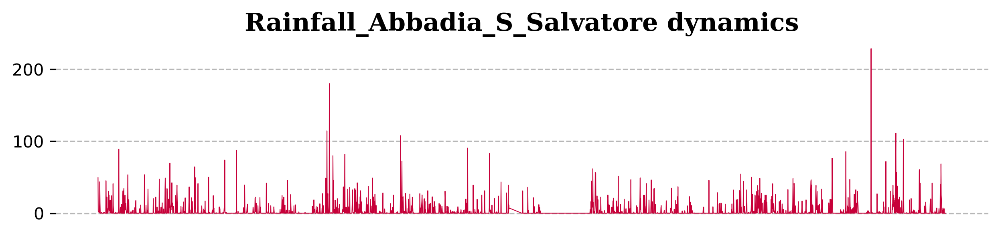

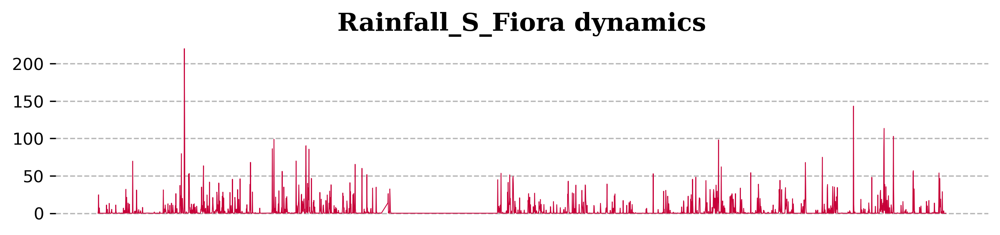

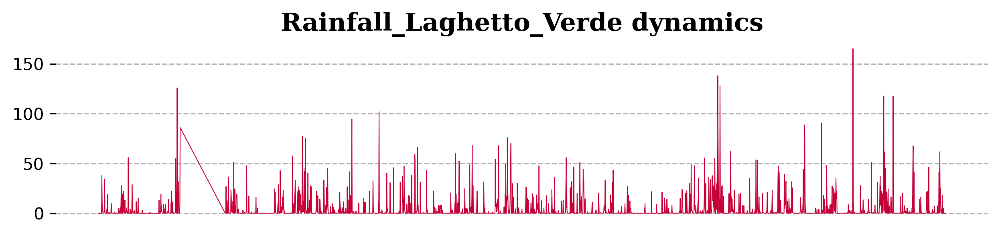

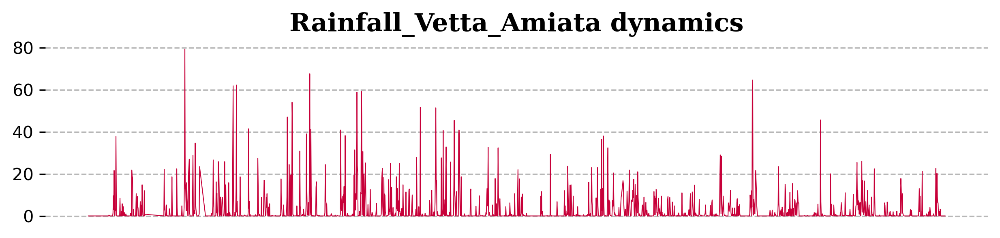

...

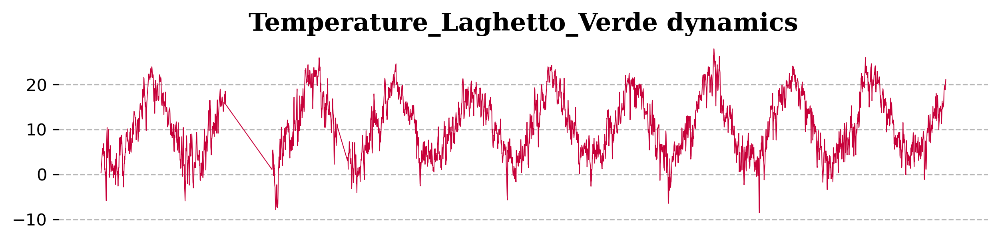

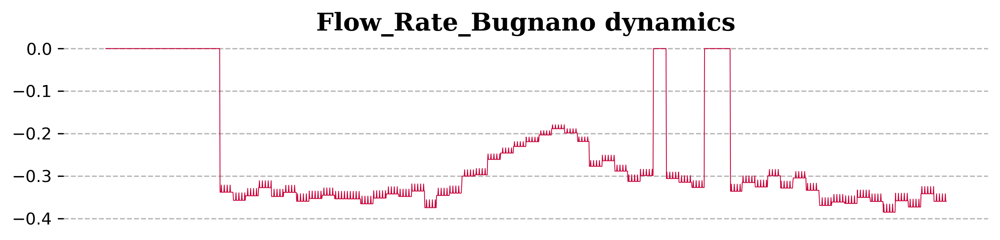

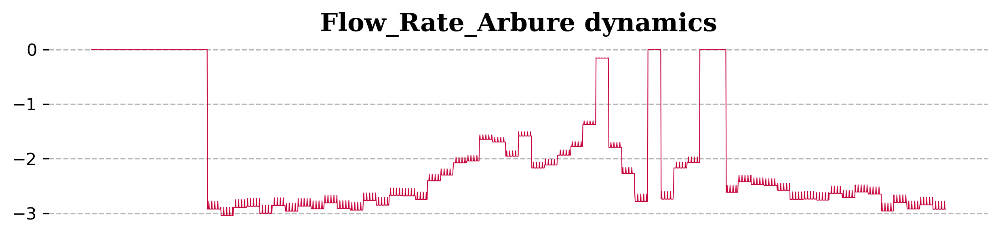

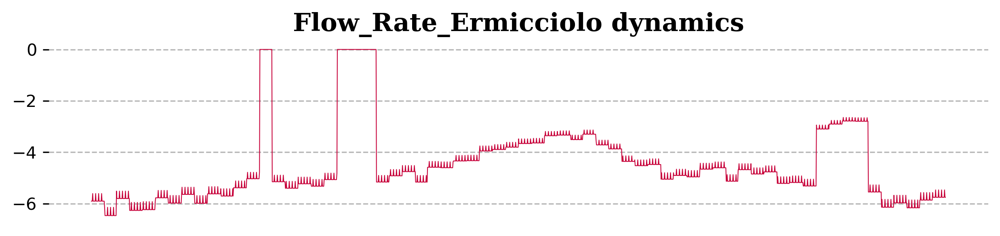

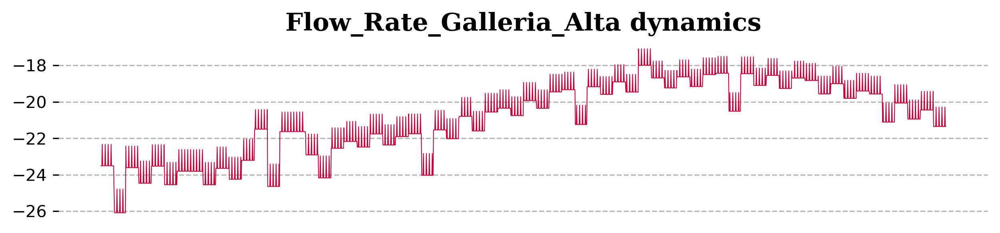

In [24]:
columns_viz(datasets[2], color = '#C70039')

In [20]:
datasets[3].head()

,Rainfall_S_Piero,Rainfall_Mangona,Rainfall_S_Agata,Rainfall_Cavallina,Rainfall_Le_Croci,Temperature_Le_Croci,Lake_Level,Flow_Rate
Date,,,,,,,,
03/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
04/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
05/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
06/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
07/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.44,0.31


In [26]:
print('The earliest date: \t%s' %datasets[3].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[3].index.values[[0, -1]][1])

The earliest date: 	03/06/2002
The latest date: 	30/06/2020


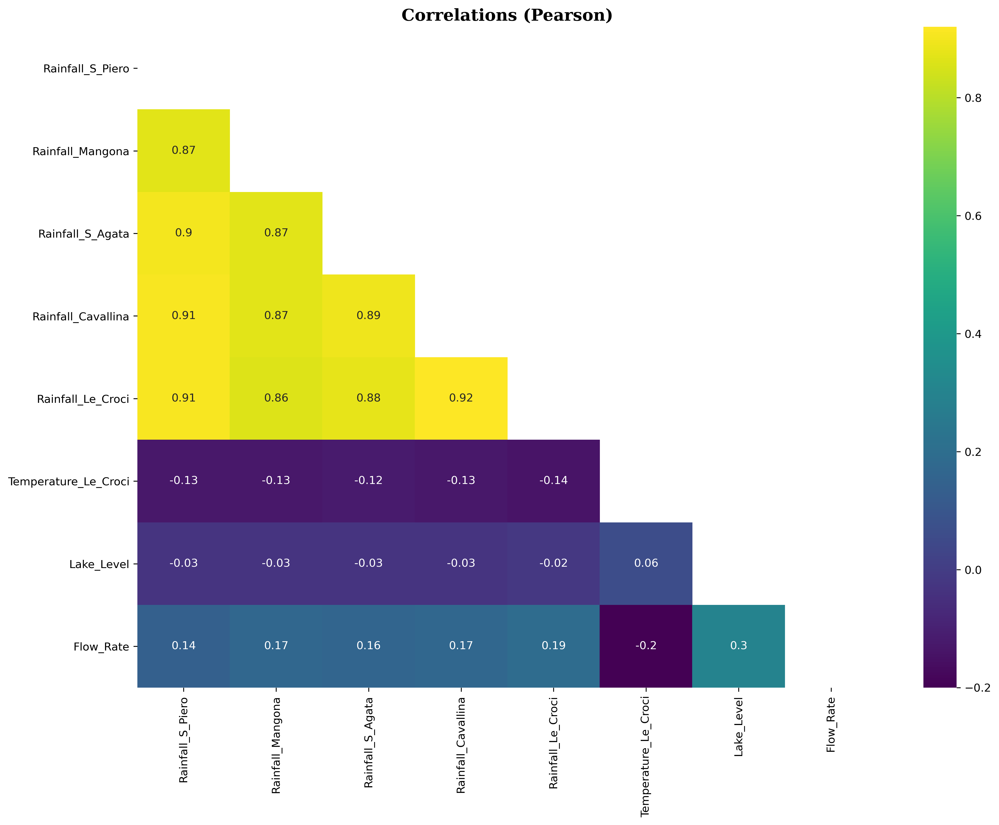

In [21]:
corr_plot(datasets[3])

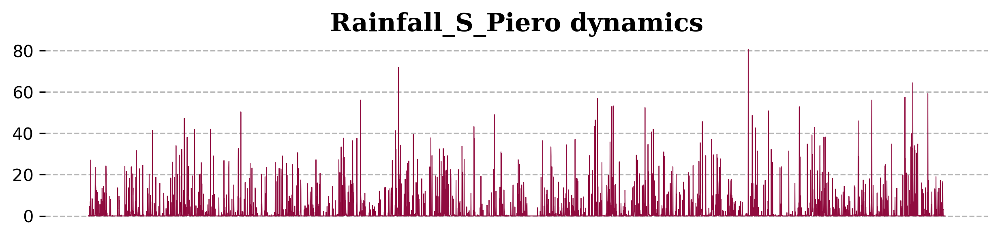

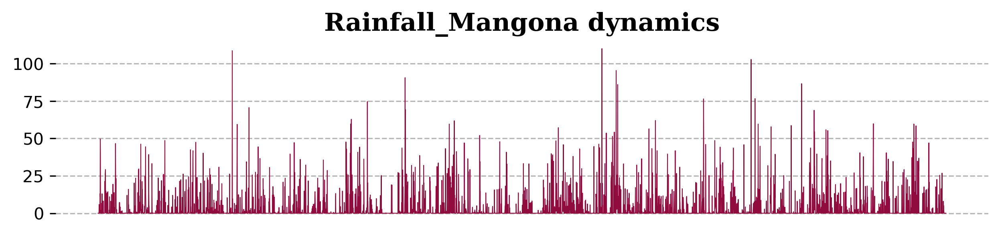

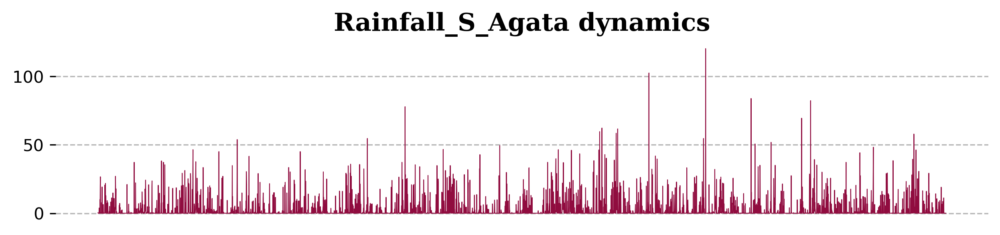

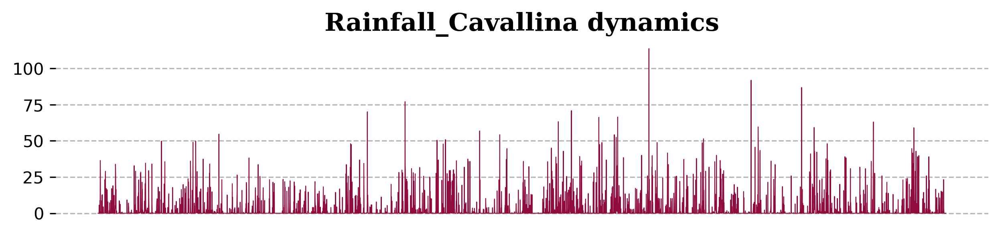

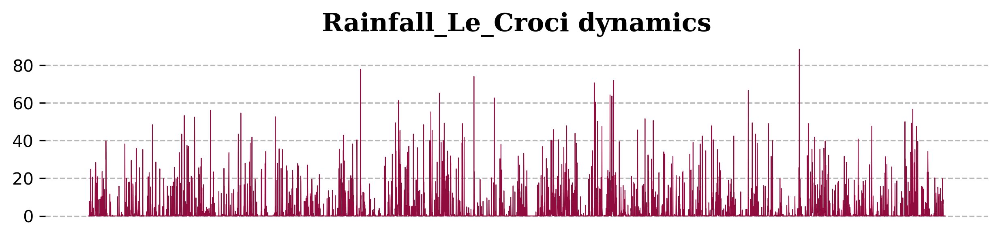

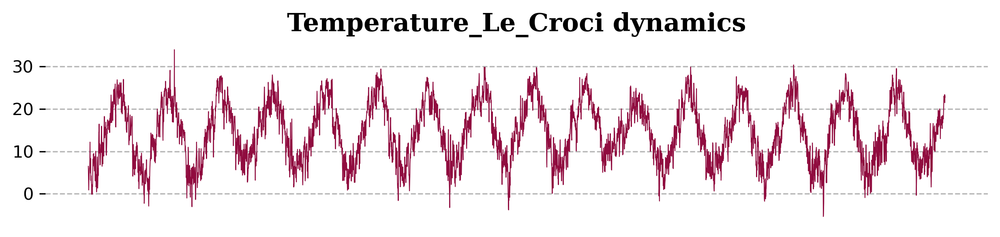

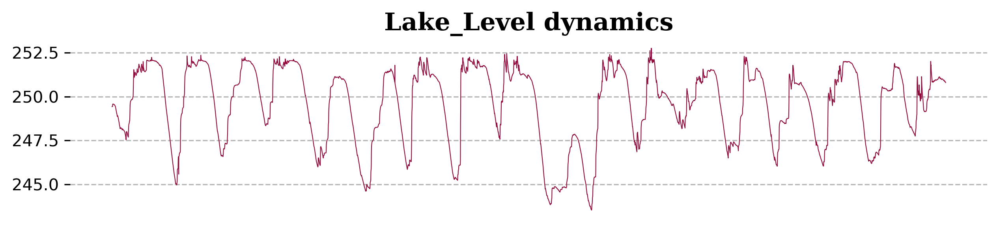

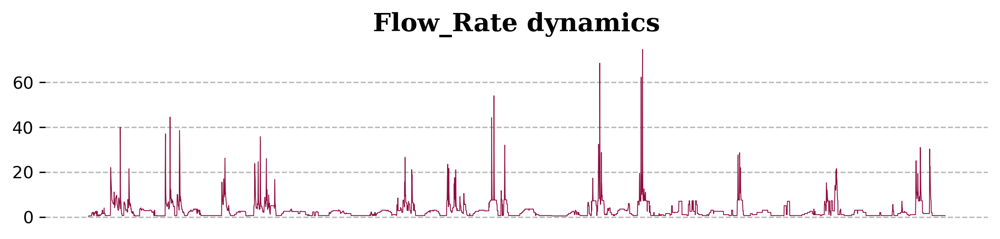

In [28]:
columns_viz(datasets[3], color = '#900C3F')

In [22]:
datasets[4].head()

,Rainfall_Settefrati,Temperature_Settefrati,Flow_Rate_Madonna_di_Canneto
Date,,,
01/01/2012,0.0,5.25,NaN
02/01/2012,5.6,6.65,NaN
03/01/2012,10.0,8.85,NaN
04/01/2012,0.0,6.75,NaN
05/01/2012,1.0,5.55,NaN


In [23]:
datasets[4].index.values[[0, -1]]

array(['01/01/2012', nan], dtype=object)

In [24]:
datasets[4].index.dropna().values[[0, -1]]

array(['01/01/2012', '30/06/2020'], dtype=object)

In [25]:
datasets[4].index.values[[0, -1]]

array(['01/01/2012', nan], dtype=object)

In [30]:
print('The earliest date: \t%s' %datasets[4].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[4].index.dropna().values[[0, -1]][1])

The earliest date: 	01/01/2012
The latest date: 	30/06/2020


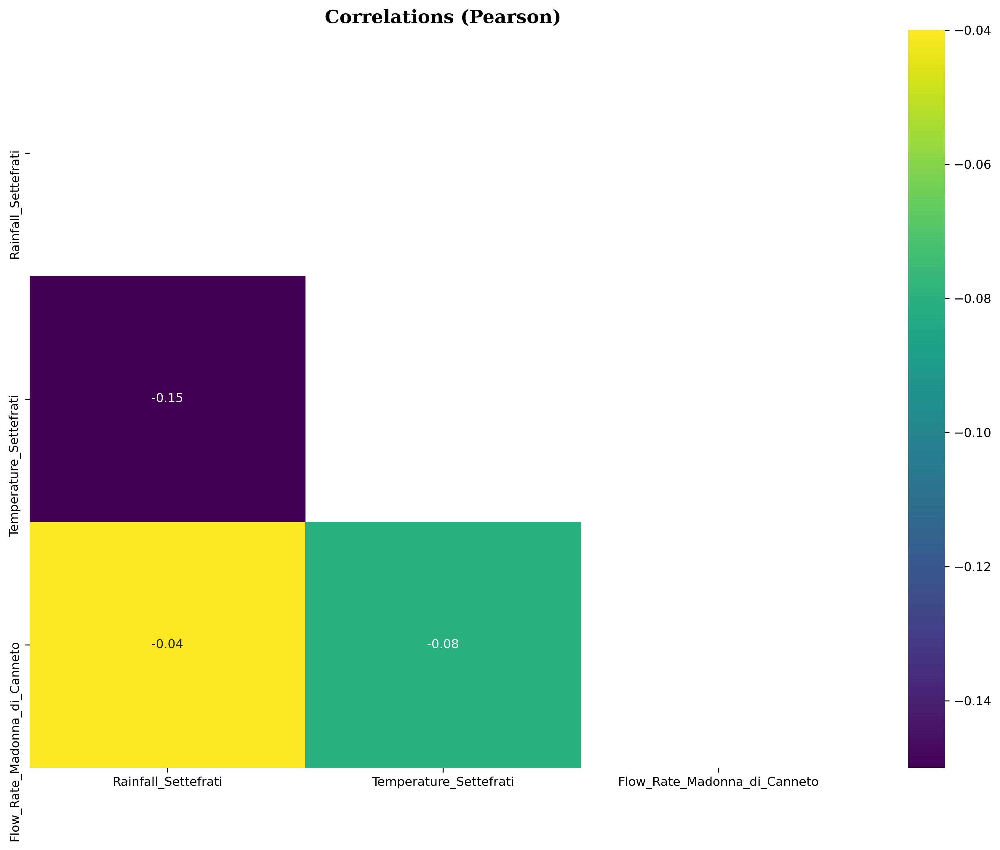

In [31]:
corr_plot(datasets[4])

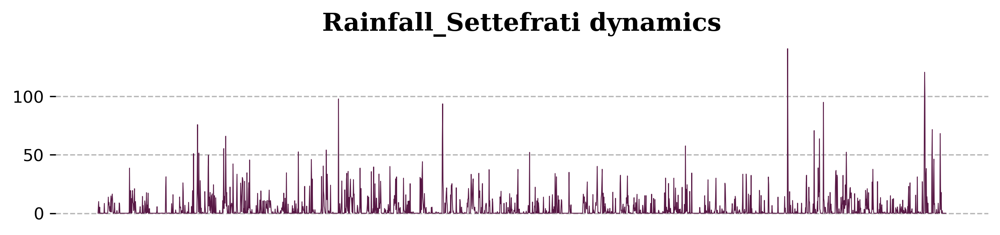

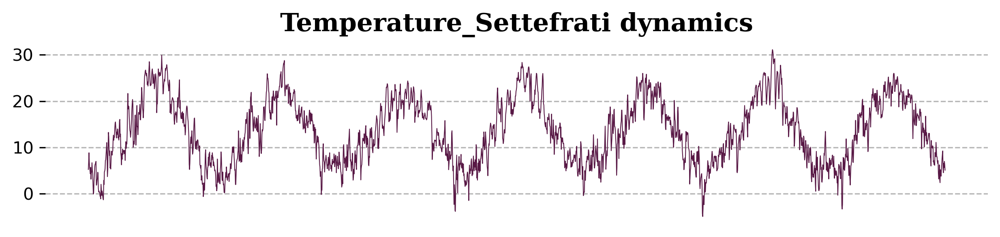

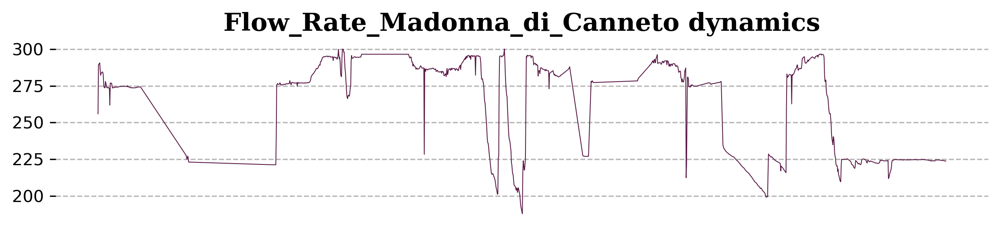

In [32]:
columns_viz(datasets[4], color = '#581845')

In [33]:
datasets[5].head()

,Rainfall_Simignano,Rainfall_Siena_Poggio_al_Vento,Rainfall_Mensano,Rainfall_Montalcinello,Rainfall_Monticiano_la_Pineta,Rainfall_Sovicille,Rainfall_Ponte_Orgia,Rainfall_Scorgiano,Rainfall_Pentolina,Rainfall_Monteroni_Arbia_Biena,...,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1,Volume_Pozzo_3,Volume_Pozzo_4
Date,,,,,,,,,,,,,,,,,,,,,
01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,5.50,0.80,NaN,NaN,NaN
02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,6.20,3.25,NaN,NaN,NaN
03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.25,0.95,NaN,NaN,NaN
04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.00,4.20,NaN,NaN,NaN
05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.90,6.55,NaN,NaN,NaN


In [34]:
print('The earliest date: \t%s' %datasets[5].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[5].index.values[[0, -1]][1])

The earliest date: 	01/01/2000
The latest date: 	30/06/2020


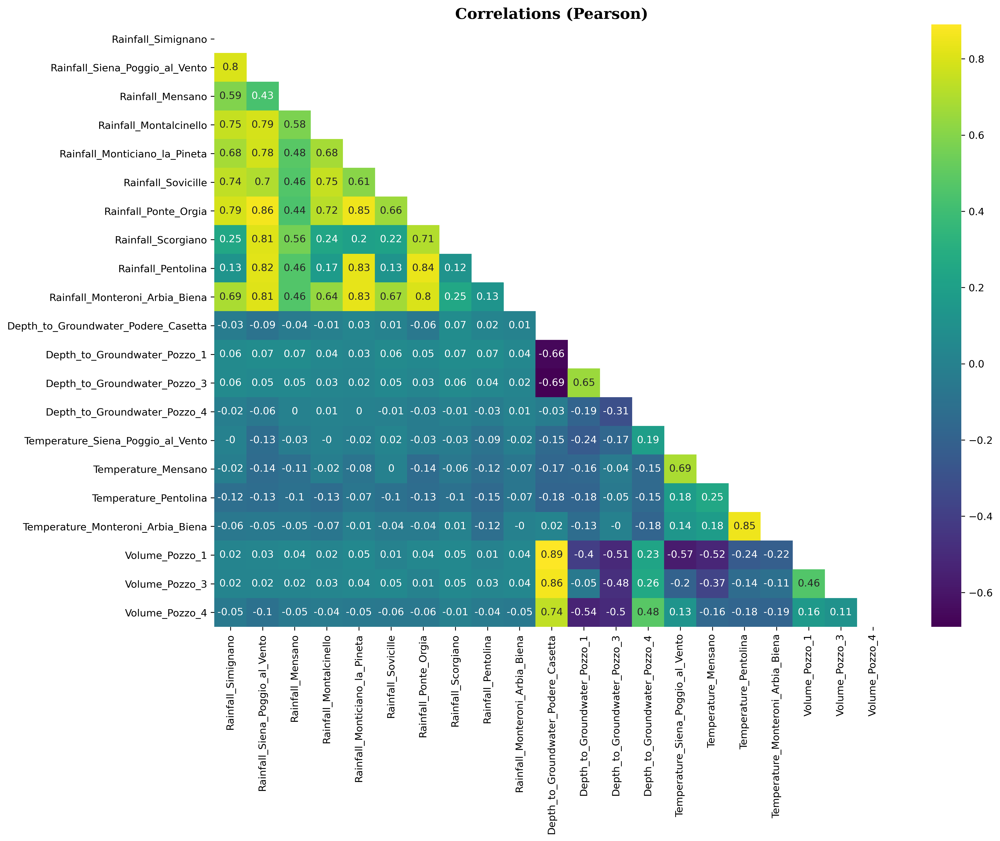

In [35]:
corr_plot(datasets[5])

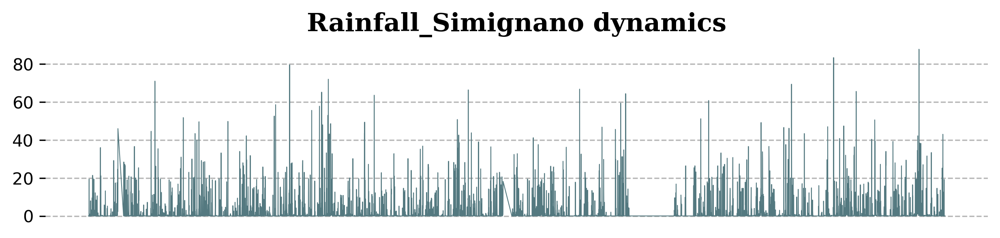

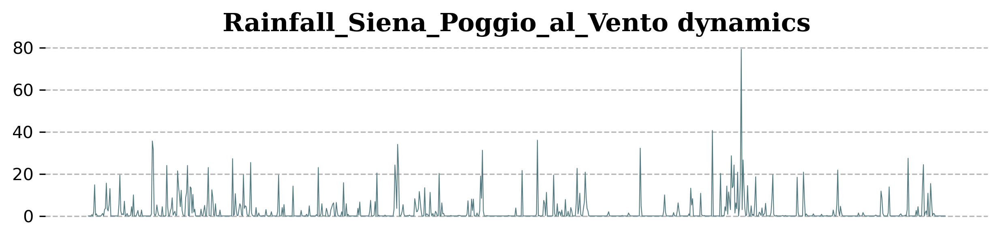

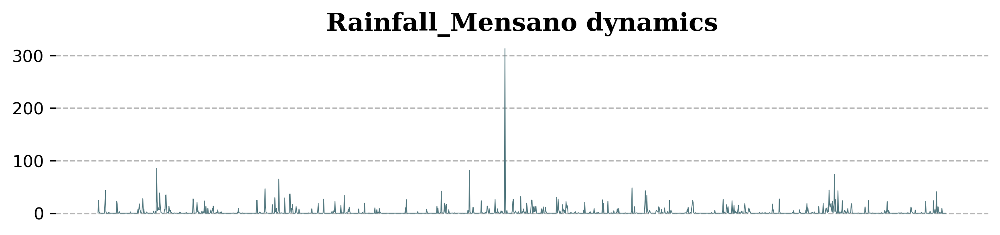

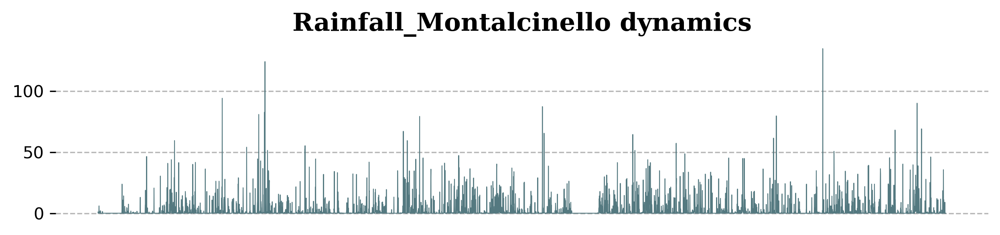

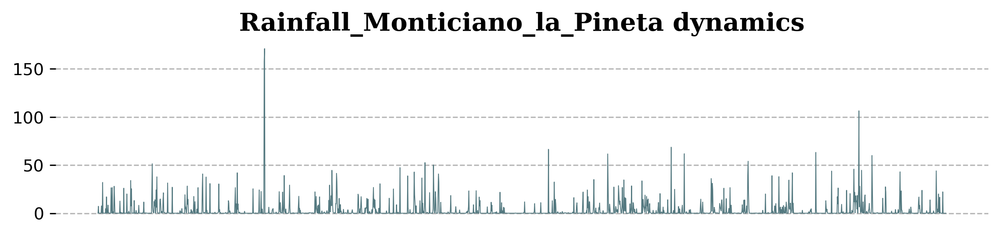

...

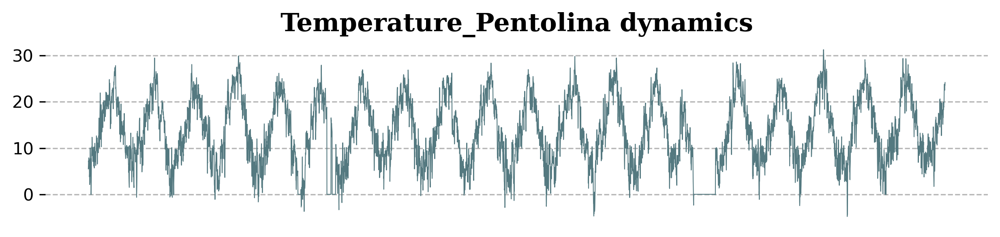

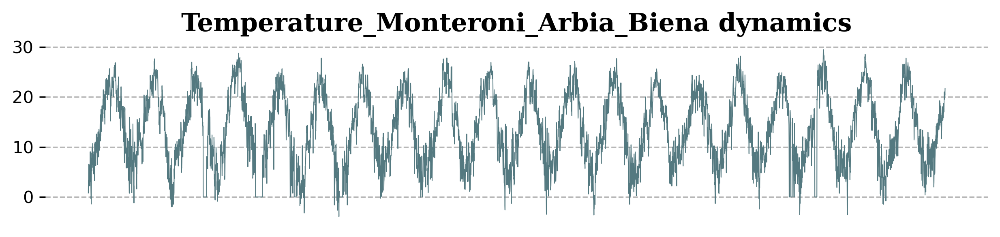

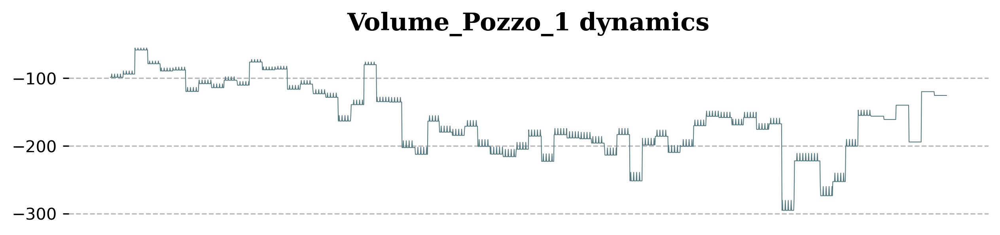

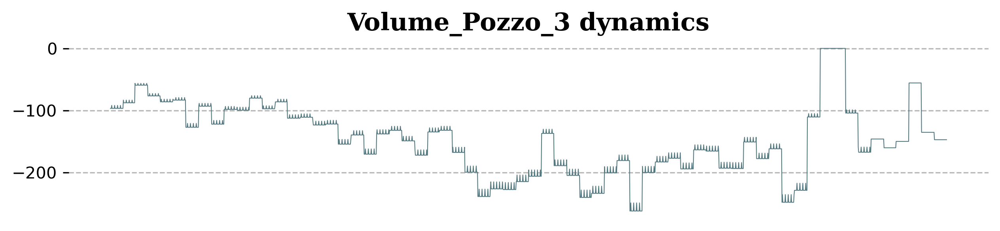

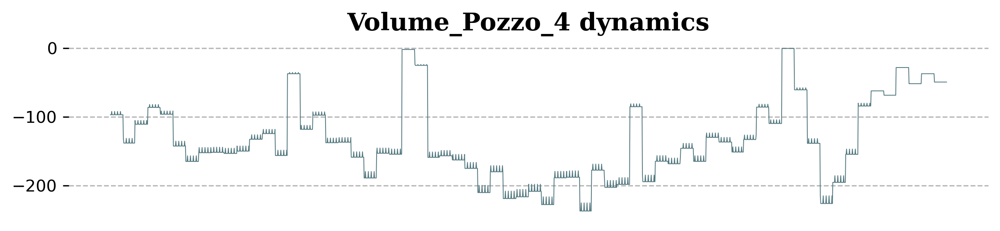

In [36]:
columns_viz(datasets[5], color = '#547980')

In [37]:
datasets[6].head()

,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
Date,,,,,,,
14/03/2006,NaN,-22.48,-22.18,NaN,NaN,NaN,NaN
15/03/2006,NaN,-22.38,-22.14,NaN,NaN,NaN,NaN
16/03/2006,NaN,-22.25,-22.04,NaN,NaN,NaN,NaN
17/03/2006,NaN,-22.38,-22.04,NaN,NaN,NaN,NaN
18/03/2006,NaN,-22.60,-22.04,NaN,NaN,NaN,NaN


In [38]:
print('The earliest date: \t%s' %datasets[6].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[6].index.values[[0, -1]][1])

The earliest date: 	14/03/2006
The latest date: 	30/06/2020


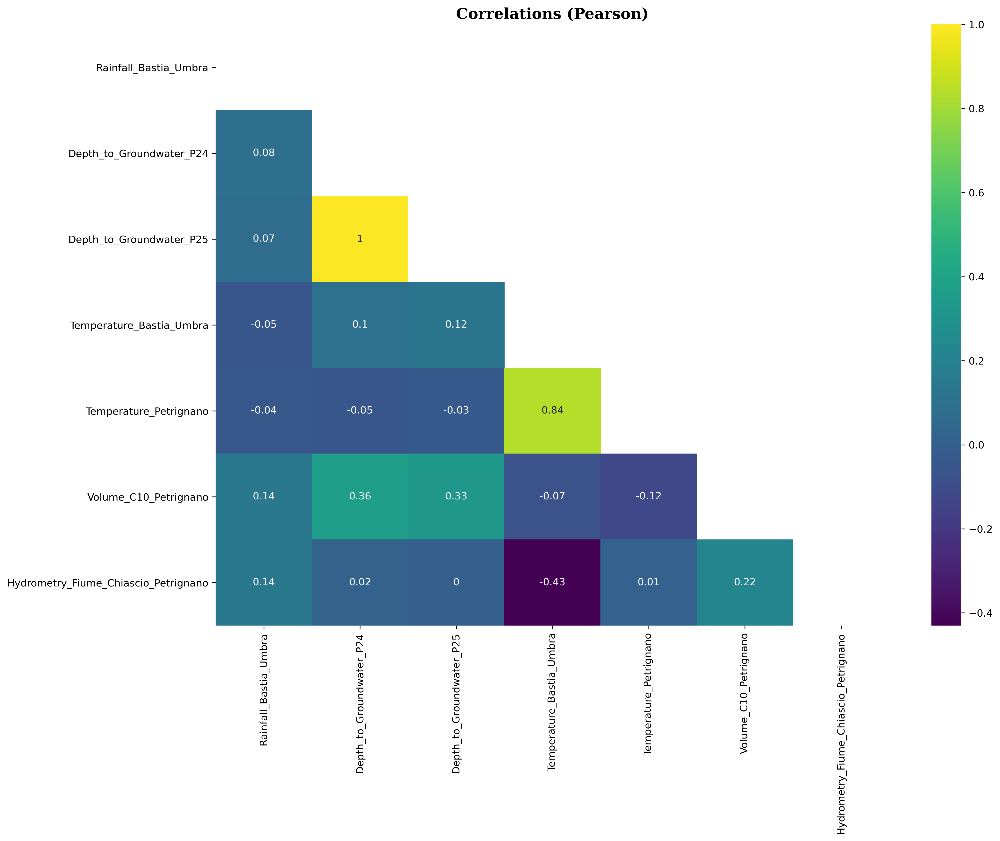

In [39]:
corr_plot(datasets[6])

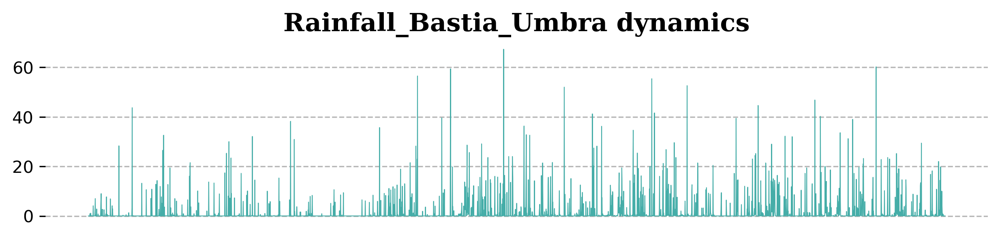

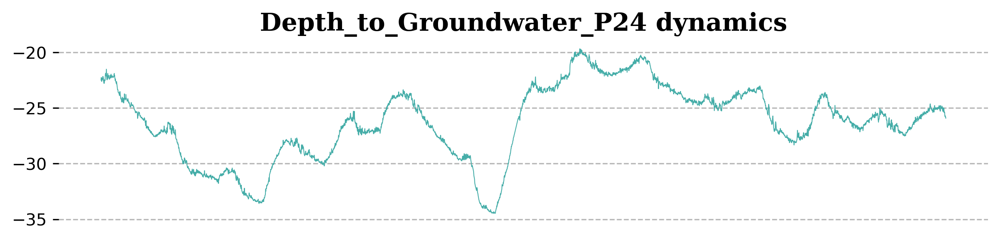

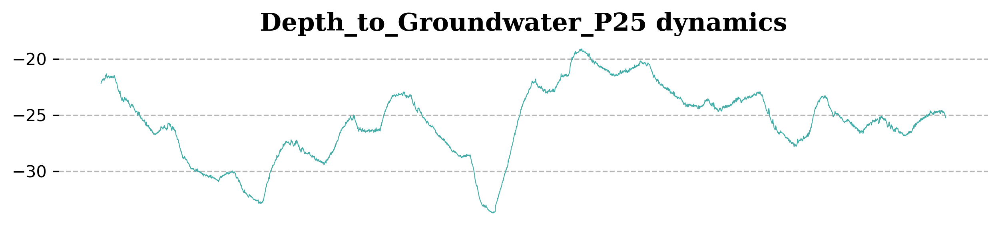

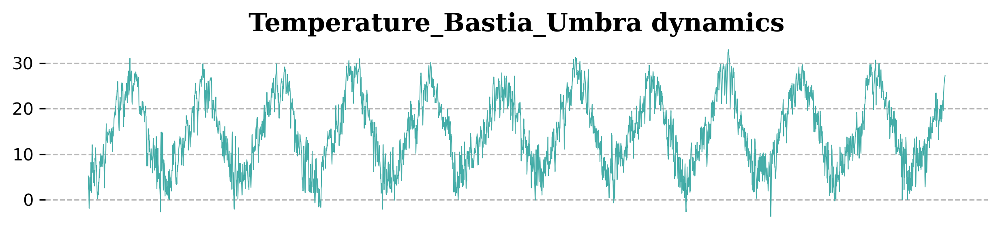

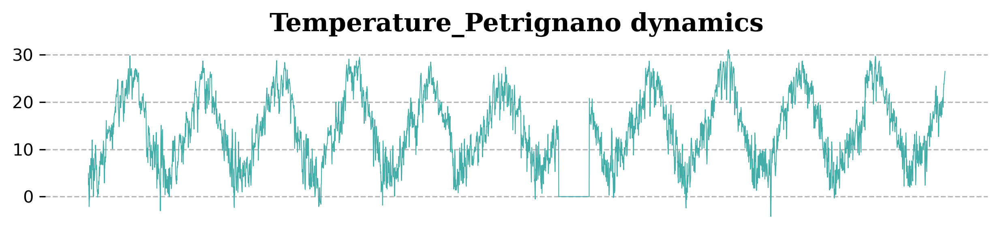

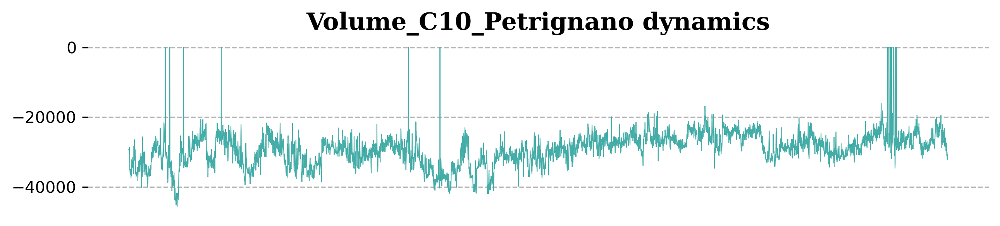

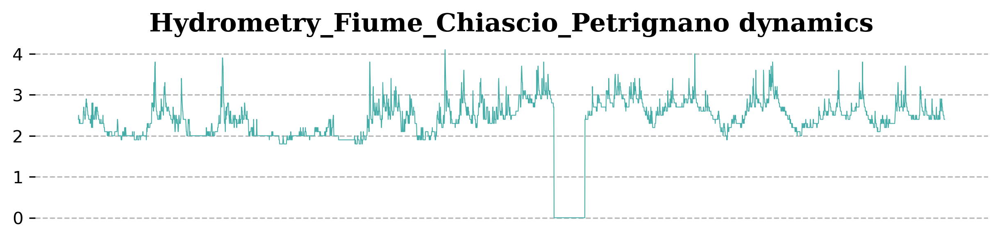

In [40]:
columns_viz(datasets[6], color = '#45ADA8')

In [41]:
datasets[7].head()

,Rainfall_Terni,Flow_Rate_Lupa
Date,,
01/01/2009,2.797,NaN
02/01/2009,2.797,NaN
03/01/2009,2.797,NaN
04/01/2009,2.797,NaN
05/01/2009,2.797,NaN


In [42]:
print('The earliest date: \t%s' %datasets[7].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[7].index.values[[0, -1]][1])

The earliest date: 	01/01/2009
The latest date: 	30/06/2020


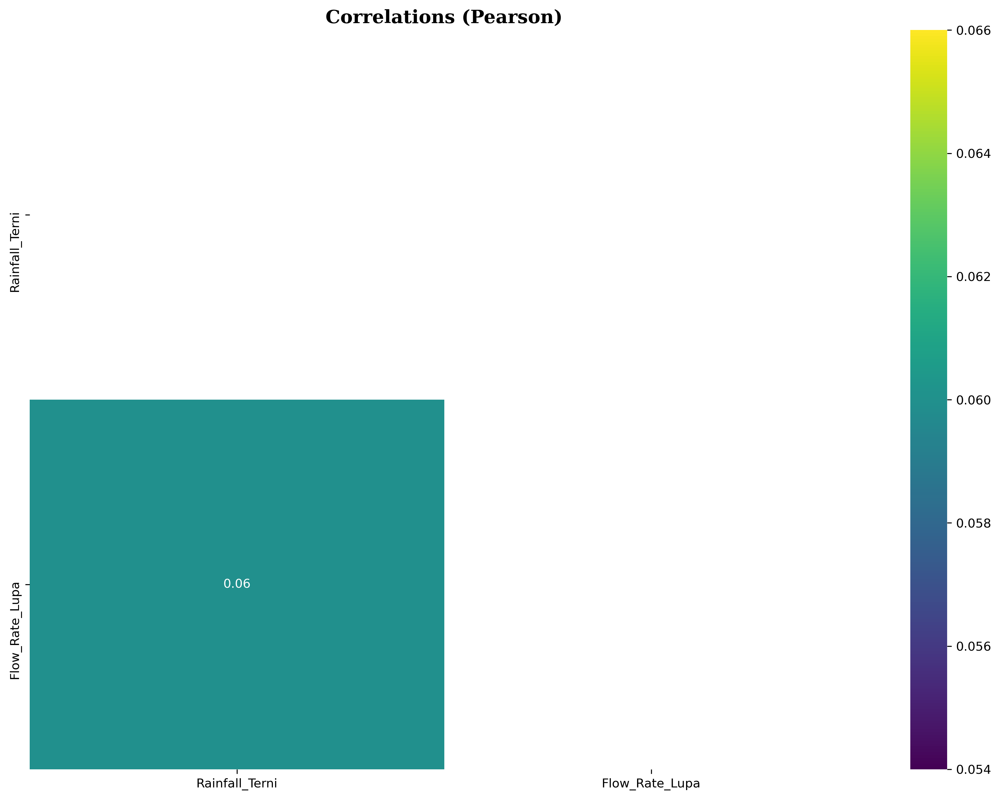

In [43]:
corr_plot(datasets[7])

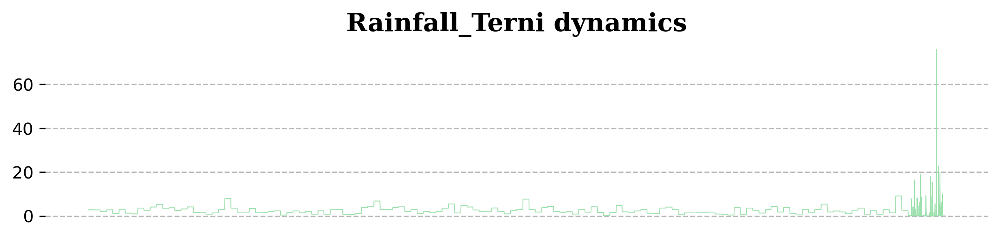

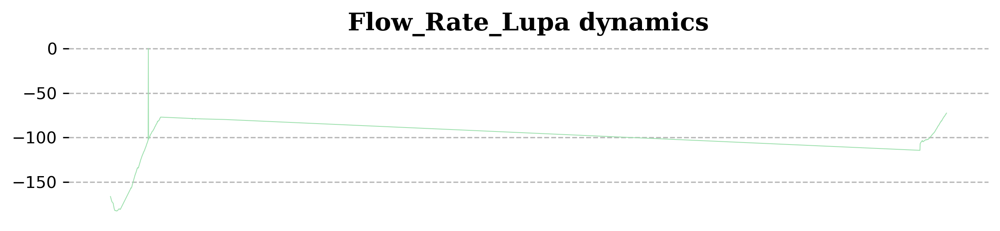

In [44]:
columns_viz(datasets[7], color = '#9DE0AD')

In [45]:
datasets[8].head()

,Rainfall_Le_Croci,Rainfall_Cavallina,Rainfall_S_Agata,Rainfall_Mangona,Rainfall_S_Piero,Rainfall_Vernio,Rainfall_Stia,Rainfall_Consuma,Rainfall_Incisa,Rainfall_Montevarchi,Rainfall_S_Savino,Rainfall_Laterina,Rainfall_Bibbiena,Rainfall_Camaldoli,Temperature_Firenze,Hydrometry_Nave_di_Rosano
Date,,,,,,,,,,,,,,,,
01/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.82
02/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.94
03/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.11
04/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.84
05/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.88


In [46]:
print('The earliest date: \t%s' %datasets[8].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[8].index.values[[0, -1]][1])

The earliest date: 	01/01/1998
The latest date: 	30/06/2020


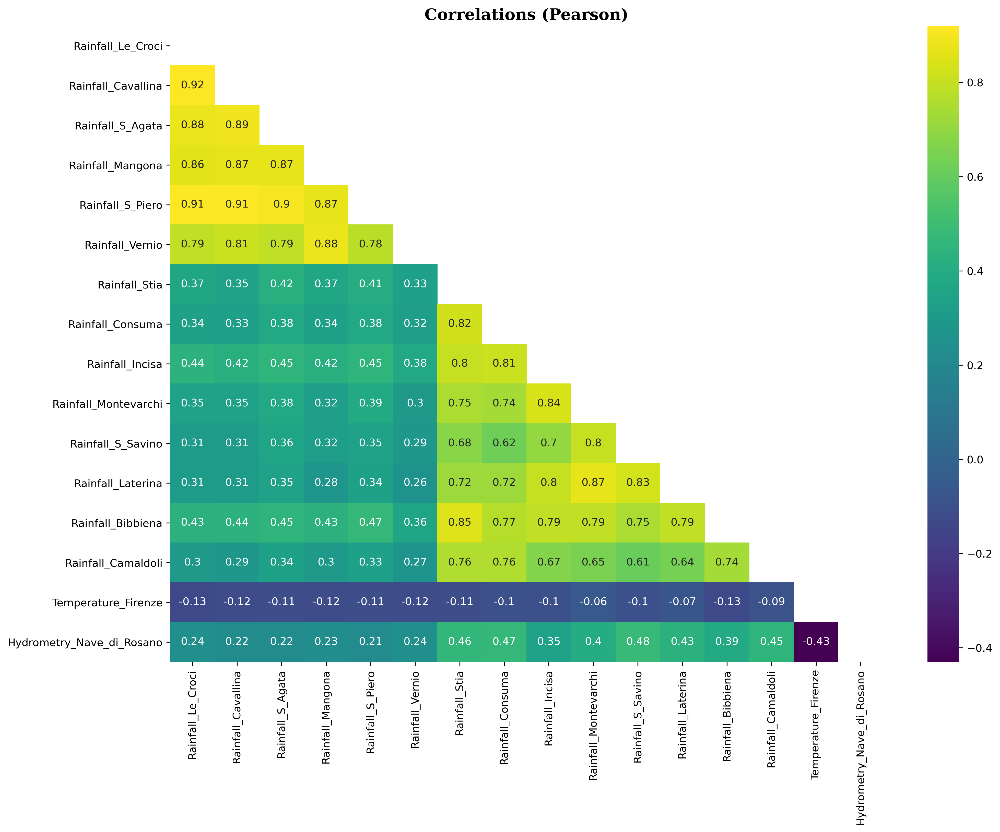

In [47]:
corr_plot(datasets[8])

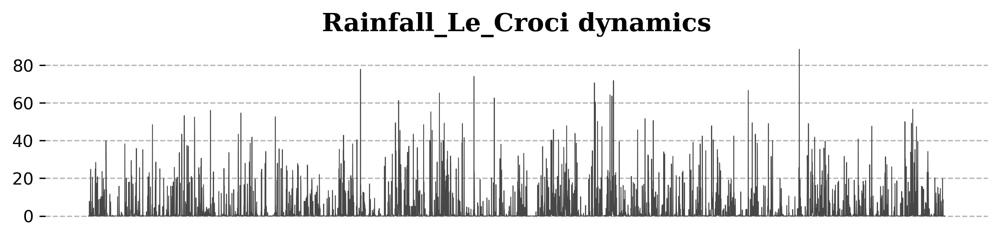

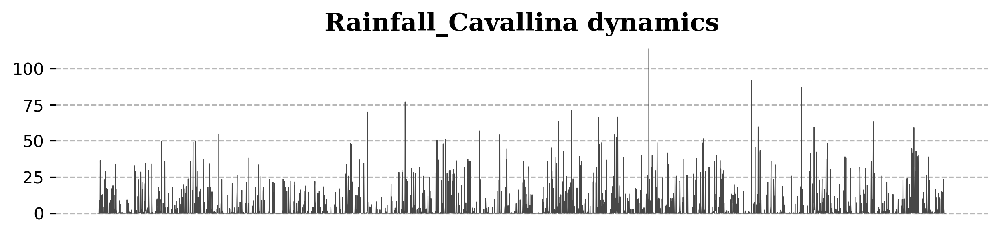

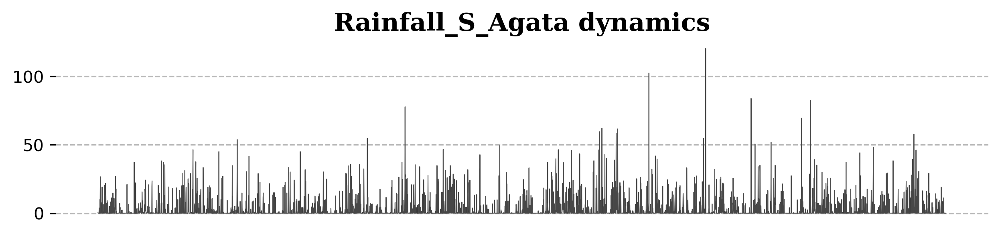

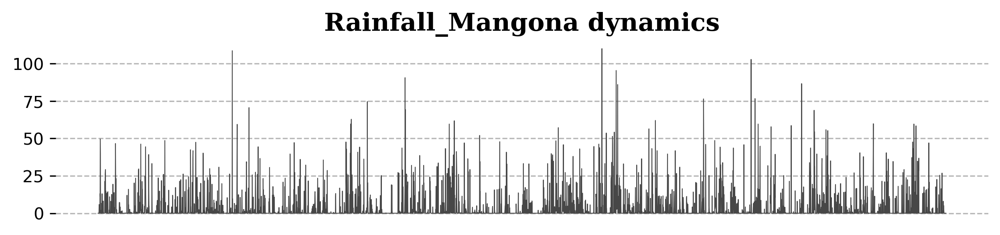

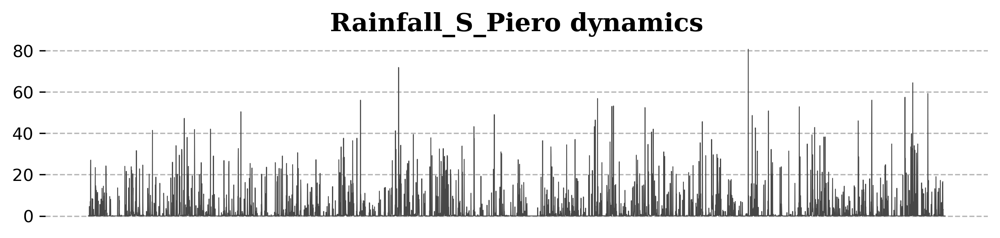

...

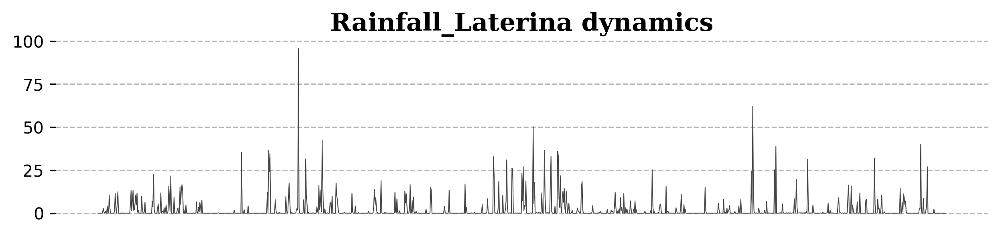

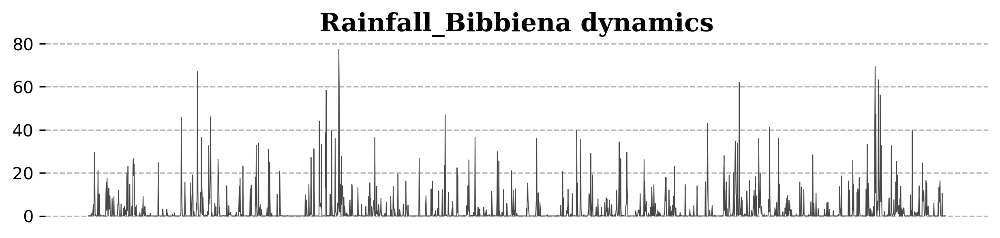

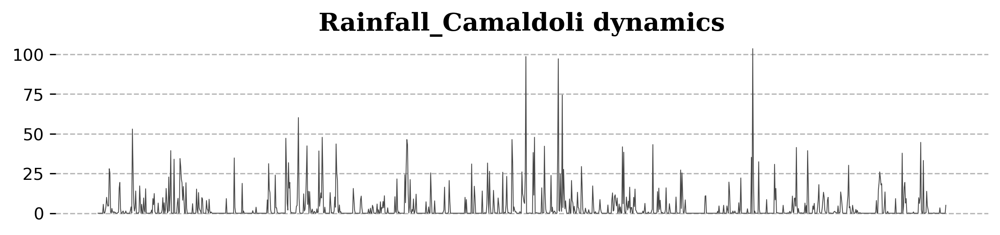

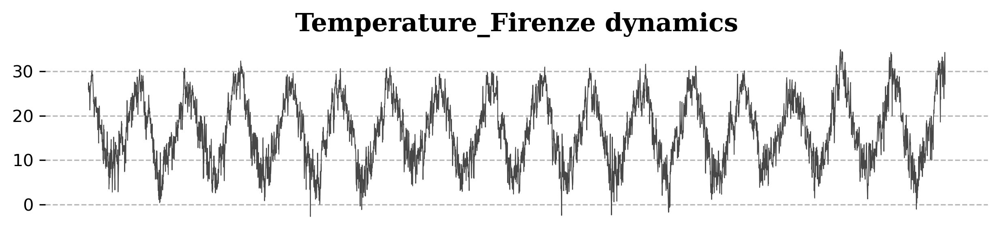

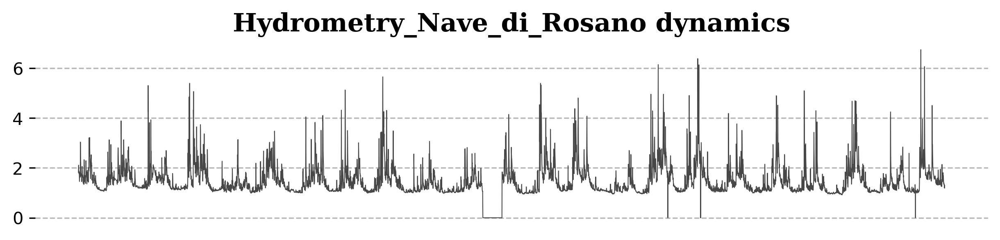

In [48]:
columns_viz(datasets[8], color = '#474747')

In [49]:
df = River_Arno[['Hydrometry_Nave_di_Rosano', 'Temperature_Firenze']].reset_index()

In [50]:
df

,Date,Hydrometry_Nave_di_Rosano,Temperature_Firenze
0,01/01/1998,1.82,NaN
1,02/01/1998,1.94,NaN
2,03/01/1998,2.11,NaN
3,04/01/1998,1.84,NaN
4,05/01/1998,1.88,NaN
...,...,...,...
8212,26/06/2020,1.34,NaN
8213,27/06/2020,1.21,NaN
8214,28/06/2020,1.30,NaN
8215,29/06/2020,1.19,NaN


In [51]:
River_Arno 

,Rainfall_Le_Croci,Rainfall_Cavallina,Rainfall_S_Agata,Rainfall_Mangona,Rainfall_S_Piero,Rainfall_Vernio,Rainfall_Stia,Rainfall_Consuma,Rainfall_Incisa,Rainfall_Montevarchi,Rainfall_S_Savino,Rainfall_Laterina,Rainfall_Bibbiena,Rainfall_Camaldoli,Temperature_Firenze,Hydrometry_Nave_di_Rosano
Date,,,,,,,,,,,,,,,,
01/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.82
02/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.94
03/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.11
04/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.84
05/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.88
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.34
27/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.21
28/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.30


In [52]:
River_Arno.iloc[:, 0:-2]

,Rainfall_Le_Croci,Rainfall_Cavallina,Rainfall_S_Agata,Rainfall_Mangona,Rainfall_S_Piero,Rainfall_Vernio,Rainfall_Stia,Rainfall_Consuma,Rainfall_Incisa,Rainfall_Montevarchi,Rainfall_S_Savino,Rainfall_Laterina,Rainfall_Bibbiena,Rainfall_Camaldoli
Date,,,,,,,,,,,,,,
01/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
02/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
03/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
04/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
05/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
27/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [53]:
River_Arno.iloc[:, 0:14]

,Rainfall_Le_Croci,Rainfall_Cavallina,Rainfall_S_Agata,Rainfall_Mangona,Rainfall_S_Piero,Rainfall_Vernio,Rainfall_Stia,Rainfall_Consuma,Rainfall_Incisa,Rainfall_Montevarchi,Rainfall_S_Savino,Rainfall_Laterina,Rainfall_Bibbiena,Rainfall_Camaldoli
Date,,,,,,,,,,,,,,
01/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
02/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
03/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
04/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
05/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
27/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28/06/2020,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [54]:
River_Arno.iloc[:, 0:-2].sum(axis = 1).values 

array([0., 0., 0., ..., 0., 0., 0.])

In [55]:
f = River_Arno.iloc[:, 0:-2].sum(axis = 1)

In [56]:
f = np.array(f)

In [57]:
f 

array([0., 0., 0., ..., 0., 0., 0.])

In [58]:
pd.to_datetime(df.Date).dt.year

0       1998
1       1998
2       1998
3       1998
4       1998
        ... 
8212    2020
8213    2020
8214    2020
8215    2020
8216    2020
Name: Date, Length: 8217, dtype: int64

pandas.Series.dt.year

Series.dt.year

The year of the datetime.

In [59]:
pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

0       1998/01
1       1998/02
2       1998/03
3       1998/04
4       1998/05
         ...   
8212    2020/06
8213    2020/06
8214    2020/06
8215    2020/06
8216    2020/06
Name: Date, Length: 8217, dtype: object

In [60]:
df = River_Arno[['Hydrometry_Nave_di_Rosano', 'Temperature_Firenze']].reset_index()
df['rainfall'] = River_Arno.iloc[:, 0:-2].sum(axis = 1).values
df['year'] = pd.to_datetime(df.Date).dt.year
df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

In [61]:
df 

,Date,Hydrometry_Nave_di_Rosano,Temperature_Firenze,rainfall,year,month,month_year
0,01/01/1998,1.82,NaN,0.0,1998,1,1998/01
1,02/01/1998,1.94,NaN,0.0,1998,2,1998/02
2,03/01/1998,2.11,NaN,0.0,1998,3,1998/03
3,04/01/1998,1.84,NaN,0.0,1998,4,1998/04
4,05/01/1998,1.88,NaN,0.0,1998,5,1998/05
...,...,...,...,...,...,...,...
8212,26/06/2020,1.34,NaN,0.0,2020,6,2020/06
8213,27/06/2020,1.21,NaN,0.0,2020,6,2020/06
8214,28/06/2020,1.30,NaN,0.0,2020,6,2020/06
8215,29/06/2020,1.19,NaN,0.0,2020,6,2020/06


In [62]:
r_means = np.log(df.groupby('month_year').Hydrometry_Nave_di_Rosano.mean() * 10).reset_index()

In [63]:
r_means

,month_year,Hydrometry_Nave_di_Rosano
0,1998/01,2.866432
1,1998/02,2.789850
2,1998/03,2.825977
3,1998/04,3.033349
4,1998/05,2.772992
...,...,...
271,2020/08,2.827314
272,2020/09,2.813411
273,2020/10,2.763170
274,2020/11,2.788093


In [64]:
df.groupby('month_year').Hydrometry_Nave_di_Rosano.mean().reset_index()

,month_year,Hydrometry_Nave_di_Rosano
0,1998/01,1.757419
1,1998/02,1.627857
2,1998/03,1.687742
3,1998/04,2.076667
4,1998/05,1.600645
...,...,...
271,2020/08,1.690000
272,2020/09,1.666667
273,2020/10,1.585000
274,2020/11,1.625000


Why is log used?

It lets you work backwards through a calculation. It lets you undo exponential effects. Beyond just being an inverse operation, logarithms have a few specific properties that are quite useful in their own right: Logarithms are a convenient way 

# to express large numbers.

What is the concept of log?

log 100 = 2

because

10**2 = 100

The natural logarithm log is the inverse of the exponential function, so that log(exp(x)) = x. The natural logarithm is logarithm in base e.

In [65]:
df = River_Arno[['Hydrometry_Nave_di_Rosano', 'Temperature_Firenze']].reset_index()
df['rainfall'] = River_Arno.iloc[:, 0:-2].sum(axis = 1).values
df['year'] = pd.to_datetime(df.Date).dt.year
df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

r_means = np.log(df.groupby('month_year').Hydrometry_Nave_di_Rosano.mean() * 10).reset_index()
r_means['month_year'] = pd.to_datetime(r_means['month_year'])

r_rain = np.log(df.groupby('month_year').rainfall.mean()).reset_index()
r_rain['month_year'] = pd.to_datetime(r_rain['month_year'])

r_temp = np.log(df.groupby('month_year').Temperature_Firenze.mean()).reset_index()
r_temp['month_year'] = pd.to_datetime(r_temp['month_year'])

In [66]:
df

,Date,Hydrometry_Nave_di_Rosano,Temperature_Firenze,rainfall,year,month,month_year
0,01/01/1998,1.82,NaN,0.0,1998,1,1998/01
1,02/01/1998,1.94,NaN,0.0,1998,2,1998/02
2,03/01/1998,2.11,NaN,0.0,1998,3,1998/03
3,04/01/1998,1.84,NaN,0.0,1998,4,1998/04
4,05/01/1998,1.88,NaN,0.0,1998,5,1998/05
...,...,...,...,...,...,...,...
8212,26/06/2020,1.34,NaN,0.0,2020,6,2020/06
8213,27/06/2020,1.21,NaN,0.0,2020,6,2020/06
8214,28/06/2020,1.30,NaN,0.0,2020,6,2020/06
8215,29/06/2020,1.19,NaN,0.0,2020,6,2020/06


In [67]:
r_temp

,month_year,Temperature_Firenze
0,1998-01-01,NaN
1,1998-02-01,NaN
2,1998-03-01,NaN
3,1998-04-01,NaN
4,1998-05-01,NaN
...,...,...
271,2020-08-01,NaN
272,2020-09-01,NaN
273,2020-10-01,NaN
274,2020-11-01,NaN


In [68]:
r_means = np.log(df.groupby('month_year').Hydrometry_Nave_di_Rosano.mean() * 10).reset_index()
r_means

,month_year,Hydrometry_Nave_di_Rosano
0,1998/01,2.866432
1,1998/02,2.789850
2,1998/03,2.825977
3,1998/04,3.033349
4,1998/05,2.772992
...,...,...
271,2020/08,2.827314
272,2020/09,2.813411
273,2020/10,2.763170
274,2020/11,2.788093


In [69]:
r_means

,month_year,Hydrometry_Nave_di_Rosano
0,1998/01,2.866432
1,1998/02,2.789850
2,1998/03,2.825977
3,1998/04,3.033349
4,1998/05,2.772992
...,...,...
271,2020/08,2.827314
272,2020/09,2.813411
273,2020/10,2.763170
274,2020/11,2.788093


In [70]:
r_means.month_year[::12]

0      1998/01
12     1999/01
24     2000/01
36     2001/01
48     2002/01
60     2003/01
72     2004/01
84     2005/01
96     2006/01
108    2007/01
120    2008/01
132    2009/01
144    2010/01
156    2011/01
168    2012/01
180    2013/01
192    2014/01
204    2015/01
216    2016/01
228    2017/01
240    2018/01
252    2019/01
264    2020/01
Name: month_year, dtype: object

In [71]:
r_means.month_year[::10]

0      1998/01
10     1998/11
20     1999/09
30     2000/07
40     2001/05
50     2002/03
60     2003/01
70     2003/11
80     2004/09
90     2005/07
100    2006/05
110    2007/03
120    2008/01
130    2008/11
140    2009/09
150    2010/07
160    2011/05
170    2012/03
180    2013/01
190    2013/11
200    2014/09
210    2015/07
220    2016/05
230    2017/03
240    2018/01
250    2018/11
260    2019/09
270    2020/07
Name: month_year, dtype: object

range(start, stop, step)